In [1]:
import os
import pickle
from glob import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
from scipy.stats import pearsonr
from scipy.stats import gaussian_kde

import matplotlib 
matplotlib.rc('xtick', labelsize=12) 
matplotlib.rc('ytick', labelsize=12) 


In [ ]:
n101 = 


dfs = [
    
T1L_large_HGL,
T1L_large_SFCN,
T1L_large_SFCN_50b,
T1L_large_SFCN_50b10s,

T1L_HGL,
T1L_SFCN, 
T1L_SFCN_50b,
T1L_SFCN_50b10s,
    
T1NL_HGL,
T1NL_SFCN,   
T1NL_SFCN_50b,    
T1NL_SFCN_50b10s,
    
T2NL_HGL,
T2NL_SFCN,    
T2NL_SFCN_50b,    
T2NL_SFCN_50b10s,
    
tracts_HGL,
tracts_SFCN,
tracts_SFCN_50b,
tracts_SFCN_50b10s,

    
]

names = [

'T1L_large_HGL',
'T1L_large_SFCN',
'T1L_large_SFCN_50b',
'T1L_large_SFCN_50b10s',

'T1L_HGL',
'T1L_SFCN', 
'T1L_SFCN_50b',
'T1L_SFCN_50b10s',
    
'T1NL_HGL',
'T1NL_SFCN',   
'T1NL_SFCN_50b',    
'T1NL_SFCN_50b10s',
    
'T2NL_HGL',
'T2NL_SFCN',    
'T2NL_SFCN_50b',    
'T2NL_SFCN_50b10s',
    
'tracts_HGL',
'tracts_SFCN',
'tracts_SFCN_50b',
'tracts_SFCN_50b10s',

    

]

# dfs1= []

# dfs1 = dfs.copy()

# for idx in range(len(dfs)):
    
#     dfs1[idx] = '../predictions/AM0-' + dfs1[idx] + '_predictions/output_statistics_test.csv'
    
# for idx in range(len(dfs)):
#     dfs1[idx] = pd.read_csv(dfs1[idx])
    
dfs1 = []

dfs1 = dfs.copy()

for idx in range(len(dfs)):
    
    dfs1[idx] = '../predictions/AM0-' + dfs1[idx] + '_predictions/output_statistics_test.csv'
    
for idx in range(len(dfs)):
    dfs1[idx] = pd.read_csv(dfs1[idx])

In [2]:
df = pd.read_pickle('female_test.pkl')
# df = pd.read_pickle('female_train.pkl')
# df = pd.read_pickle('female_testA.pkl')

In [3]:
df

,modality,dataframe
0,T1L_large_HGL,Unnamed: 0 target_age mean_output_age ...
1,T1L_large_SFCN,Unnamed: 0 target_age mean_output_age ...
2,T1L_large_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
3,T1L_large_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
4,T1L_HGL,Unnamed: 0 target_age mean_output_age ...
5,T1L_SFCN,Unnamed: 0 target_age mean_output_age ...
6,T1L_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
7,T1L_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
8,T1NL_HGL,Unnamed: 0 target_age mean_output_age ...
9,T1NL_SFCN,Unnamed: 0 target_age mean_output_age ...


In [4]:
df.iloc[0].dataframe

,Unnamed: 0,target_age,mean_output_age,mean_age_delta,loss,output_age_decon,output_age_decon3,age_delta_decon,age_delta_decon3
0,24806531,67.670662,65.482110,2.188553,4.789764,65.866897,65.716459,-1.803765,-1.954203
1,24237795,77.280936,73.253136,4.027800,16.223176,75.487581,75.837645,-1.793355,-1.443291
2,24748274,58.301941,55.103355,3.198585,10.230947,53.017792,53.090029,-5.284149,-5.211912
3,25463415,58.056694,61.257590,-3.200897,10.245743,60.636857,60.806181,2.580163,2.749487
4,25313661,59.653082,55.859596,3.793486,14.390536,53.954033,54.192336,-5.699049,-5.460746
...,...,...,...,...,...,...,...,...,...
5017,25475074,59.848516,55.468437,4.380079,19.185090,53.469771,53.591078,-6.378745,-6.257438
5018,22834218,60.501941,60.944664,-0.442723,0.196004,60.249449,60.505551,-0.252492,0.003611
5019,24442683,56.130708,54.607887,1.522820,2.318982,52.404393,52.388560,-3.726315,-3.742147
5020,21157566,78.016553,77.425500,0.591054,0.349344,80.653051,81.248973,2.636498,3.232420


In [59]:
def scatter_plot(x, y, xlabel, ylabel, title):
    g = sns.JointGrid()
    sns.scatterplot(x=x, y=y, ax=g.ax_joint) # can set s=10
    sns.kdeplot(x=x, linewidth=2, ax=g.ax_marg_x) 
    sns.kdeplot(y=y, linewidth=2, ax=g.ax_marg_y)

    g.ax_joint.set(xlabel=xlabel, ylabel=ylabel)

    g.ax_joint.plot([np.min(x), np.max(x)], [np.min(x), np.max(x)], linewidth=1.0, color='black', linestyle='solid', label='Equality Line')

    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b

    g.ax_joint.plot(x2, y2, 'r--', linewidth=3.0, label='Linear Regression Line')
    g.ax_joint.legend()
    
    pearson_correlation = pearsonr(x,y)[0]

    g.ax_joint.text(np.max(x), np.min(y)+0.05*np.abs(np.min(y2)), 'R='+str(round(pearson_correlation,3)), horizontalalignment='right', fontsize='large')
    print("Reg Slope:", w)

    g.fig.suptitle(title, y=1.05)

    plt.show()

def scatter_plot_heatmap(x, y, xlabel, ylabel, title, equality_line=True, set_scale=False):
    
    x = x.to_numpy()
    y = y.to_numpy()
    
    fig = plt.figure(figsize=[7.2, 7.2])
    sns.set_style("darkgrid", {'image.cmap': u'plasma'})
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    # Sort the points by density, so that the densest points are plotted last
    idx = z.argsort()
    x, y, z = x[idx], y[idx], z[idx]
    plt.scatter(x,y,c=z,s=50)
    if equality_line == True:
        plt.plot(x, x, ls="-", color = sns.xkcd_rgb['black'], label='Equality Line') #this is just the line of equality
    
    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b
    plt.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'], label='Linear Regression Line')
    
    pearson_correlation = pearsonr(x,y)[0]
#     plt.text(np.max(x), np.min(y)+0.05*np.abs(np.min(y2)), 'R='+str(round(pearson_correlation,3)), horizontalalignment='right', fontsize='large')
    
    if set_scale == True:
        x_min, x_max = np.min(x), np.max(x)
        y_min, y_max = np.min(y), np.max(y)
        c_min, c_max = min(x_min, y_min), max(x_max, y_max)
        plt.xlim([c_min-2, c_max+2])
        plt.ylim([c_min-2, c_max+2])
    
    plt.xlabel(xlabel,  fontsize=15)
    plt.ylabel(ylabel,  fontsize=15)
    
    lbl = 'Pearson R = '+str(round(pearson_correlation,3))
    plt.plot([],[],' ',label=lbl)
    
    plt.title(title, fontsize=15)
    plt.legend(fontsize=12)
    plt.show()
    
    return fig


def scatter_plot_heatmap_subplots(ax, x, y, xlabel, ylabel, title, equality_line=True, set_scale=False,
                                 set_y_scale=None, set_hard_scale=None, 
                                  title_font_size=15, x_axis_off_flag=False, y_axis_off_flag=False,
                                  ticks_font_size=12,
                                  plot_legend_flag = True, legend_font = 12, plot_full_legend=True,
                                  text_x=40, text_y=40,
                                 ):
    
    x = x.to_numpy()
    y = y.to_numpy()
    
    sns.set_style("darkgrid", {'image.cmap': u'plasma'})
    xy = np.vstack([x,y])
    z = gaussian_kde(xy)(xy)
    # Sort the points by density, so that the densest points are plotted last
    srt = z.argsort()
    x, y, z = x[srt], y[srt], z[srt]
    ax.scatter(x,y,c=z,s=50)
    if equality_line == True:
        if plot_full_legend==True:
            ax.plot(x, x, ls="-", color = sns.xkcd_rgb['black'], label='Equality Line') #this is just the line of equality
        else:
            ax.plot(x, x, ls="-", color = sns.xkcd_rgb['black']) #this is just the line of equality


    X_mat=np.vstack((np.ones(len(x)), x)).T
    beta_hat = np.linalg.inv(X_mat.T.dot(X_mat)).dot(X_mat.T).dot(y)
    b,w = beta_hat[0],beta_hat[1]
    x2 = np.linspace(np.min(x),np.max(x),num=10)
    y2 = w * x2 + b
    if plot_full_legend==True:
        ax.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'], label='Linear Regression Line')
    else:
        ax.plot(x2,y2,ls='--', color= sns.xkcd_rgb['red'])
    
    pearson_correlation = pearsonr(x,y)[0]
    
    if set_scale == True:
        x_min, x_max = np.min(x), np.max(x)
        y_min, y_max = np.min(y), np.max(y)
        c_min, c_max = min(x_min, y_min), max(x_max, y_max)
        ax.set_xlim([c_min-2, c_max+2])
        ax.set_ylim([c_min-2, c_max+2])
        
    if set_y_scale != None:
        ax.set_ylim([-set_y_scale-2, set_y_scale+2])
        
    if set_hard_scale!=None:
        ax.set_xlim([set_hard_scale[0]-2, set_hard_scale[1]+2])
        ax.set_ylim([set_hard_scale[2]-2, set_hard_scale[3]+2])
    
    ax.set_xlabel(xlabel,  fontsize=title_font_size)
    ax.set_ylabel(ylabel,  fontsize=title_font_size)
    
    ax.tick_params(axis='x', labelsize= ticks_font_size)
    ax.tick_params(axis='y', labelsize= ticks_font_size)
    
    lbl = 'Pearson R = '+str(round(pearson_correlation,3))
#     ax.plot([],[],' ',label=lbl)
    ax.text(text_x, text_y, lbl, fontsize=legend_font)
    
    ax.set_title(title, fontsize=title_font_size)
    if plot_legend_flag == True:
        ax.legend(fontsize=legend_font, loc=2)
    
    if x_axis_off_flag == True:
        ax.axes.xaxis.set_ticklabels([])
    if y_axis_off_flag == True:
        ax.axes.yaxis.set_ticklabels([])
    
def get_corr_plot(array, title, labels, partial_correlation=False, fig_size=None, fix_colorbar_scale=False):
    with sns.axes_style("white"):
        if fig_size == None:
            fig = plt.figure() # can set figsize=(fig_size = 12.8, fig_size)
        else:
            fig = plt.figure(figsize=(fig_size, fig_size))
        ax = fig.add_subplot(111)
        if fix_colorbar_scale == True:
            cax = ax.matshow(array, interpolation='nearest',cmap='viridis', vmin=0, vmax=1)
        else:
            cax = ax.matshow(array, interpolation='nearest',cmap='viridis')
        fig.colorbar(cax)
        if partial_correlation == False:
            intro = "Pearson R"
        else:
            intro = "Partial Correlation"
        plt.title("{} for {}".format(intro, title), fontsize=fig_size+5 if fig_size != None else 10)
        ax.set_yticks(np.arange(len(labels)))
        ax.set_yticklabels(labels)
        ax.xaxis.set_ticks_position("bottom")
        ax.set_xticks(np.arange(len(labels)))
        ax.set_xticklabels(labels, rotation=90)
        plt.show()

def correlation_plot(df, key, title, partial_correlation= False, fig_size=None, fix_colorbar_scale=False):
    
    names = df.modality.to_list()
    
    if partial_correlation == False:
        corr_df1 = []
        for idx1 in range(len(df)):
            df1 = df.iloc[idx1].dataframe
            corr_df2 = []
            for idx2 in range(len(df)):
                df2 = df.iloc[idx2].dataframe
                r, _ = pearsonr(df1[key], df2[key])
                corr_df2.append(r)
            corr_df2 = np.array(corr_df2).astype('float32')
            corr_df1.append(corr_df2)
        corr_df1 = np.array(corr_df1).astype('float32')
        get_corr_plot(corr_df1, labels=names, partial_correlation=partial_correlation,
                      title=title, fig_size=fig_size, fix_colorbar_scale=fix_colorbar_scale) 
    else:
        tmp_dct = {}
        for idx in range(len(df)):
            tmp_df = df.iloc[idx].dataframe[key]
            tmp_dct[names[idx]] = tmp_df.to_numpy()
        pcorr_df = pd.DataFrame.from_dict(tmp_dct)
        del tmp_dct, tmp_df
        
        # This implementation comes from https://pingouin-stats.org/index.html
        # Source code here for pcorr: https://github.com/raphaelvallat/pingouin/blob/72e447d539f8cfbd6b9c9c5041e267de748fe124/pingouin/correlation.py

        V = pcorr_df.cov()
        Vi = np.linalg.pinv(V, hermitian=True)
        D = np.diag(np.sqrt(1 / np.diag(Vi)))
        pcor = -1 * (D @ Vi @ D)
        pcor[np.diag_indices_from(pcor)] = 1
        get_corr_plot(pcor, labels=names, partial_correlation=partial_correlation,
                      title=title, fig_size=fig_size, fix_colorbar_scale=fix_colorbar_scale) 
        
def kde_plot(x, y, xlabel, ylabel, title):
    plt.figure()
    sns.kdeplot(x, label='Ground Truth')
    sns.kdeplot(y, label= ylabel)
    plt.legend()
    plt.title(title)
    
def kde_subplot(ax, x, y, xlegend=None, ylegend=None, xlabel=None, ylabel=None, title=None,
               title_font_size=15, x_axis_off_flag=False, y_axis_off_flag=False, set_hard_scale=None,
                ticks_font_size=12, 
                plot_legend_flag = True, legend_font = 12,
               ):
    
    if ylegend == None:
        ylegend = ['Predicted Brain Ages', 'Debiased Predicted Brain Ages']
    
    ax.tick_params(axis='x', labelsize= ticks_font_size)
    ax.tick_params(axis='y', labelsize= ticks_font_size)
    
    sns.kdeplot(x, ax=ax, label= xlegend, color = sns.xkcd_rgb['black'], linewidth = 2)
    if isinstance(y, list):
        for i, ys in enumerate(y):
            sns.kdeplot(ys, ax=ax, label= ylegend[i], linewidth = 2)
    else:
        sns.kdeplot(y, ax=ax, label= ylegend)
    ax.set_xlabel(xlabel,  fontsize=15)
    ax.set_ylabel(ylabel,  fontsize=title_font_size)
    ax.set_title(title, fontsize=title_font_size)
    if plot_legend_flag == True:
        ax.legend(fontsize=legend_font, loc=2)
    if x_axis_off_flag == True:
        ax.axes.xaxis.set_ticklabels([])
    if y_axis_off_flag == True:
        ax.axes.yaxis.set_ticklabels([])
    if set_hard_scale!=None:
        ax.set_xlim([set_hard_scale[0]-2, set_hard_scale[1]+2])
        ax.set_ylim([set_hard_scale[2]-0.001, set_hard_scale[3]+0.001])


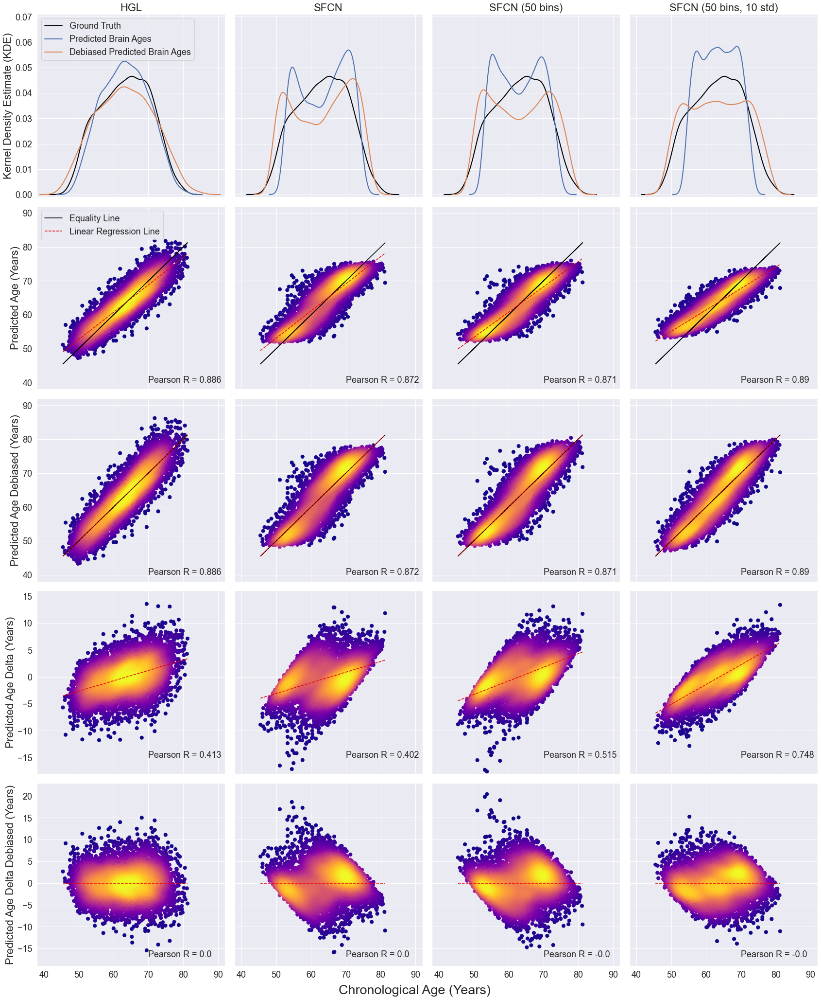

In [60]:
titles = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

legends = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

ncols=4
nrows=5
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

i = 0

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Kernel Density Estimate (KDE)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=titles[idx],
                set_hard_scale = [40,90,0,0.07],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break
    

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.mean_output_age, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=True,
                                  title_font_size=title_font_size, 
                                  set_hard_scale = [40,90,40,90],
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = plot_legend_flag, legend_font = legend_font, 
                                  plot_full_legend=plot_full_legend,
                                  text_x=70, text_y=40,
                                 )
    i+=1
    if idx == 3:
        break

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Debiased (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.output_age_decon, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False,
                                        set_hard_scale = [40,90,40,90],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font,
                                  text_x=70, text_y=40,
                                 )
    i+=1
    if idx == 3:
        break
    
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Delta (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.mean_age_delta, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False, equality_line=False, 
#                                   set_y_scale=14,
                                  set_hard_scale = [40,90,-16,14],
                                 title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font,
                                  text_x=70, text_y=-15,
                                 )
    i+=1
    if idx == 3:
        break
        
    

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Delta Debiased (Years)'
        x_axis_off_flag=False
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=False
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.age_delta_decon, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False, equality_line=False, 
#                                   set_y_scale=21,
                                  set_hard_scale = [40,90,-17,21],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font, 
                                  text_x=70, text_y=-17,
                                 )
    i+=1
    if idx == 3:
        break
    


fig.subplots_adjust(wspace=0.05, hspace=0.05)
fig.supxlabel('Chronological Age (Years)', y=0.11, fontsize=title_font_size+5, verticalalignment='top')
    
# handles, labels = axes.get_legend_handles_labels()
# fig.legend(handles, labels, loc='upper center')
# plt.figlegend( lines, labels, loc = 'lower center', ncol=5, labelspacing=0. )
# lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
# lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
# fig.legend(lines, labels)
    
fig.savefig('Scatter_Plots_FULL.png', bbox_inches='tight')
    

In [46]:
df.iloc[0].dataframe

,Unnamed: 0,target_age,mean_output_age,mean_age_delta,loss,output_age_decon,output_age_decon3,age_delta_decon,age_delta_decon3
0,24806531,67.670662,65.482110,2.188553,4.789764,65.866897,65.716459,-1.803765,-1.954203
1,24237795,77.280936,73.253136,4.027800,16.223176,75.487581,75.837645,-1.793355,-1.443291
2,24748274,58.301941,55.103355,3.198585,10.230947,53.017792,53.090029,-5.284149,-5.211912
3,25463415,58.056694,61.257590,-3.200897,10.245743,60.636857,60.806181,2.580163,2.749487
4,25313661,59.653082,55.859596,3.793486,14.390536,53.954033,54.192336,-5.699049,-5.460746
...,...,...,...,...,...,...,...,...,...
5017,25475074,59.848516,55.468437,4.380079,19.185090,53.469771,53.591078,-6.378745,-6.257438
5018,22834218,60.501941,60.944664,-0.442723,0.196004,60.249449,60.505551,-0.252492,0.003611
5019,24442683,56.130708,54.607887,1.522820,2.318982,52.404393,52.388560,-3.726315,-3.742147
5020,21157566,78.016553,77.425500,0.591054,0.349344,80.653051,81.248973,2.636498,3.232420


In [6]:
# # correlation_plot(df, key='mean_output_age', title='Mean Output Age', fig_size=20)
# # correlation_plot(df, key='mean_age_delta', title='Mean Age Delta', fig_size=20)
# # correlation_plot(df, key='output_age_decon', title='Output Age Deconfounded', fig_size=20)
# correlation_plot(df, key='age_delta_decon', title='Age Delta Debiased', 
#                  partial_correlation=False, fig_size=20)
# # correlation_plot(df, key='age_delta_decon', title='Age Delta Deconfounded', fig_size=20, 
# #                  partial_correlation=False, fix_colorbar_scale=True)

In [7]:
# correlation_plot(df, key='age_delta_decon', title='Age Delta Debiased', 
#                  partial_correlation=True, fig_size=20)
# # correlation_plot(df, key='age_delta_decon', title='Age Delta Deconfounded', fig_size=20, 
# #                  partial_correlation=True, fix_colorbar_scale=True)

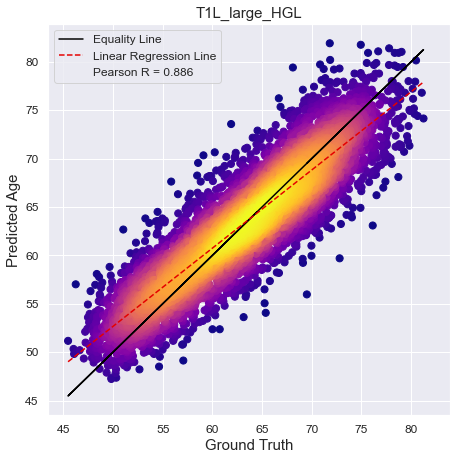

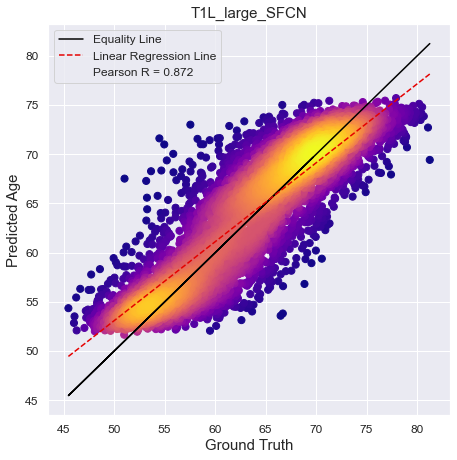

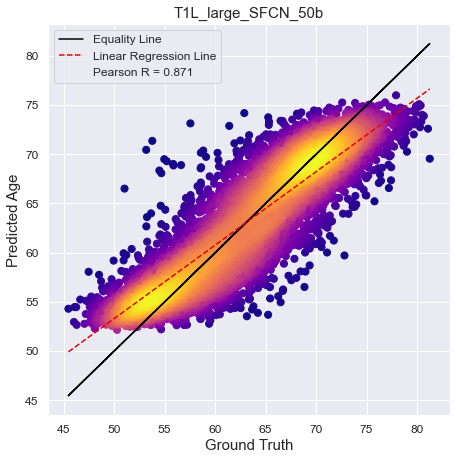

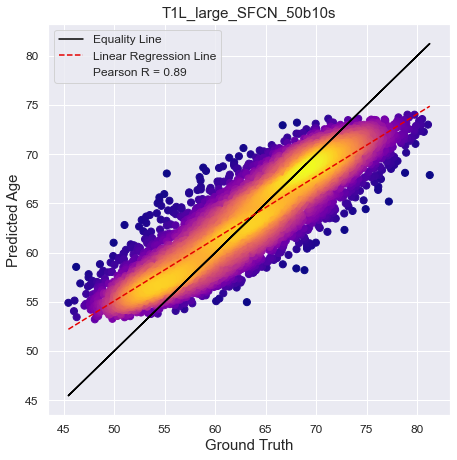

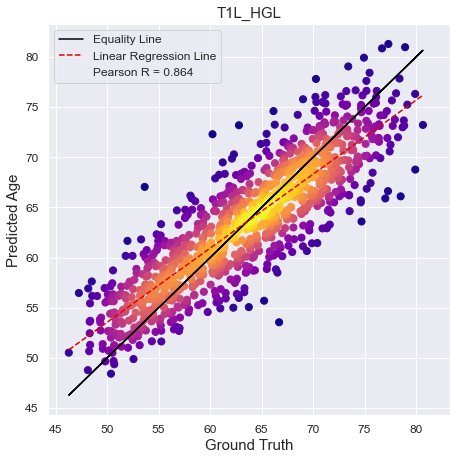

...

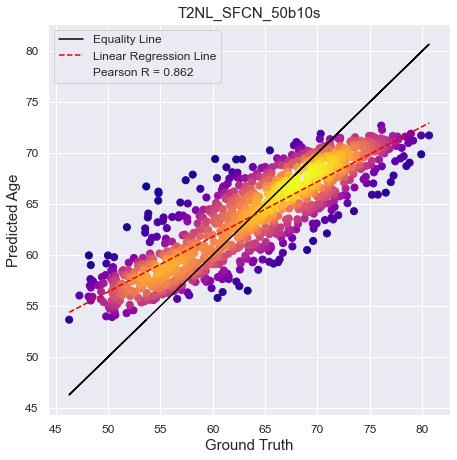

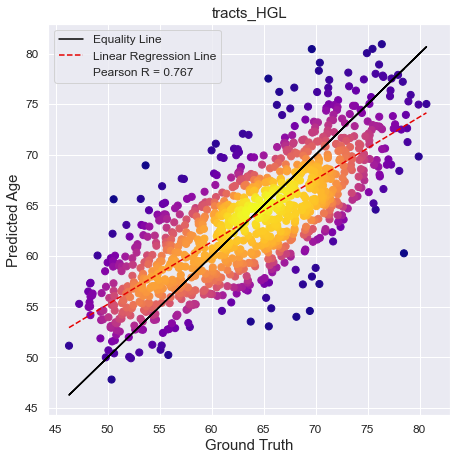

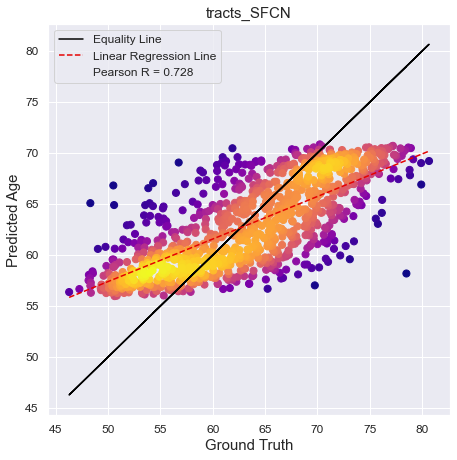

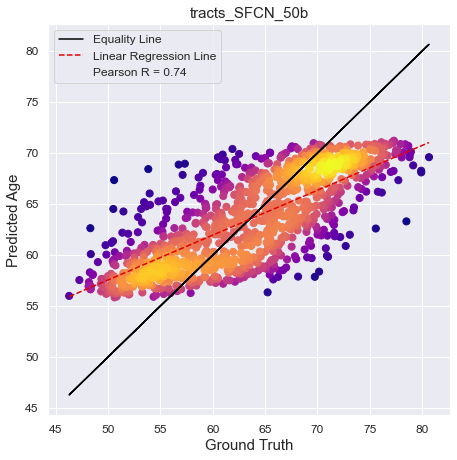

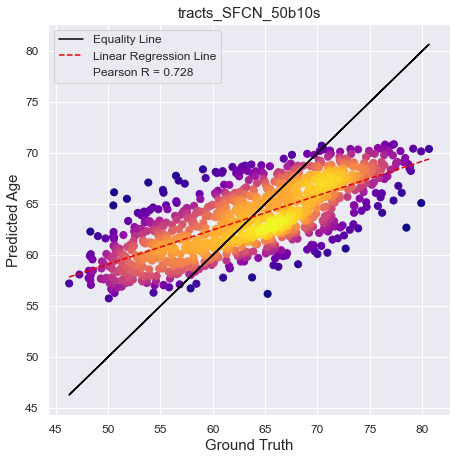

In [42]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.mean_output_age, xlabel='Ground Truth', 
                               ylabel='Predicted Age', title=name_mod, set_scale=True)

In [8]:
# titles = [
#     'HGL: T1 Linear, Large Female Dataset',
#     'SFCN: T1 Linear, Large Female Dataset',
#     'SFCN (50 bins): T1 Linear, Large Female Dataset',
#     'SFCN (50 bins, 10 std): T1 Linear, Large Female Dataset',
# ]

# for idx in range(len(df)):
#     df_mod = df.iloc[idx].dataframe
#     name_mod = df.iloc[idx].modality
#     fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.mean_output_age, xlabel='Ground Truth', 
#                                ylabel='Predicted Age', title=titles[idx], set_scale=True)
    
#     fig.savefig(titles[idx] + '_AGE_SCATTER.png', bbox_inches='tight')
    
#     if idx == 3:
#         break

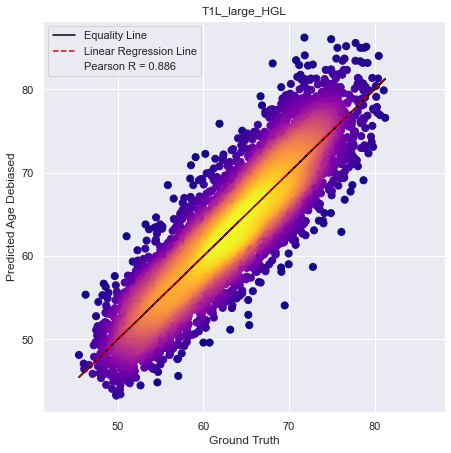

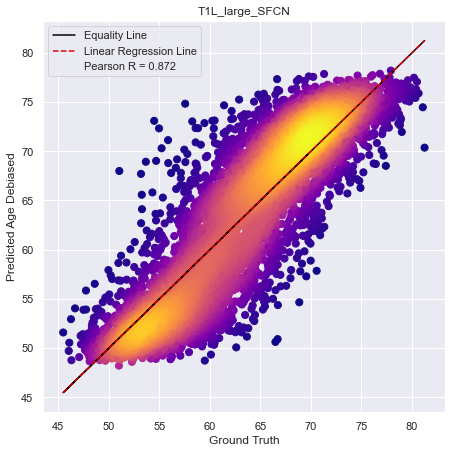

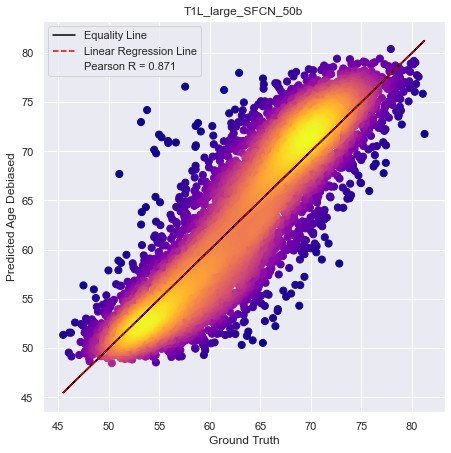

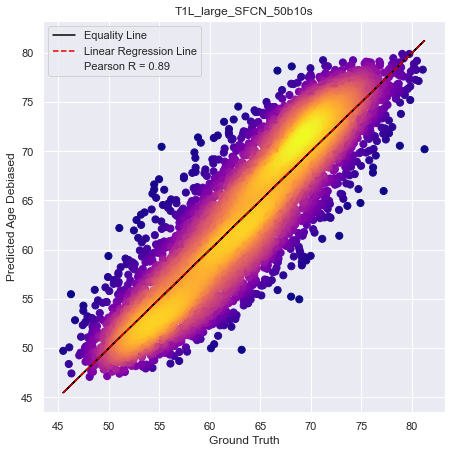

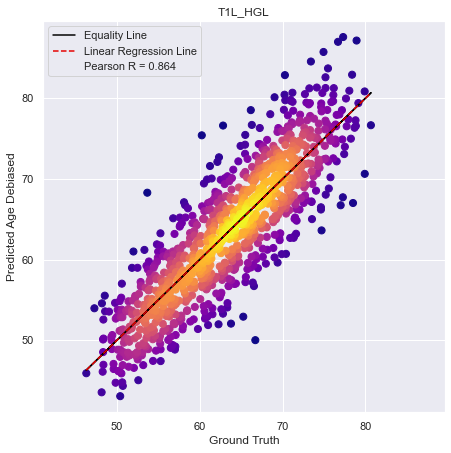

...

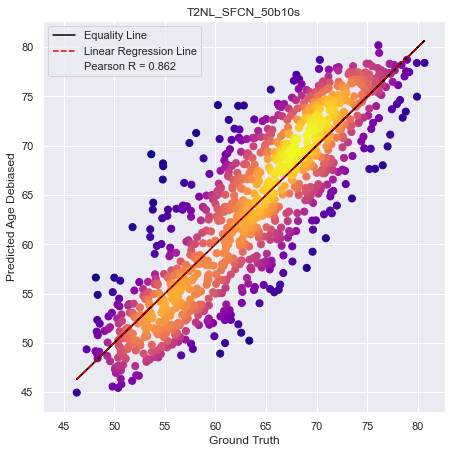

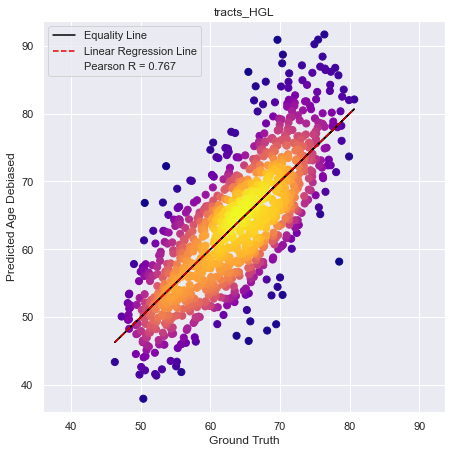

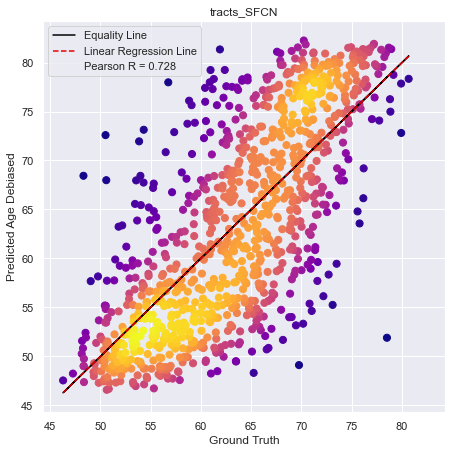

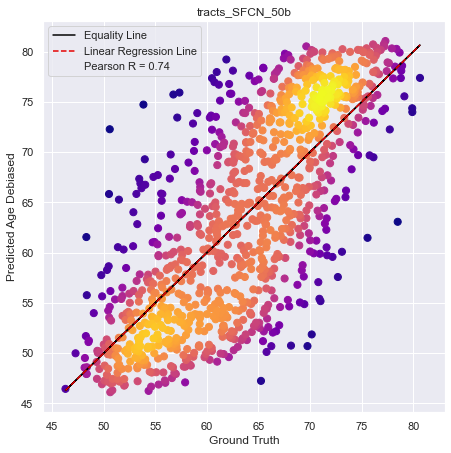

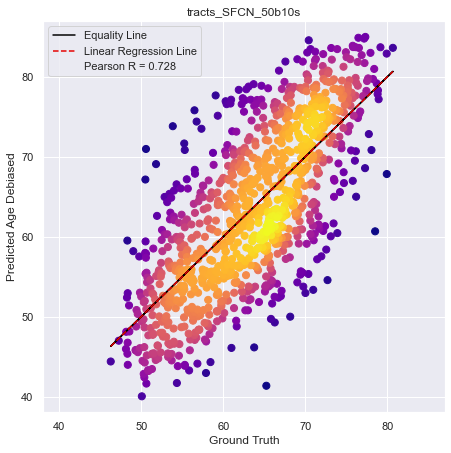

In [9]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.output_age_decon, xlabel='Ground Truth', 
                               ylabel='Predicted Age Debiased', title=name_mod, set_scale=True)

In [10]:
# figs = []

# titles = [
#     'HGL: T1 Linear, Large Female Dataset',
#     'SFCN: T1 Linear, Large Female Dataset',
#     'SFCN (50 bins): T1 Linear, Large Female Dataset',
#     'SFCN (50 bins, 10 std): T1 Linear, Large Female Dataset',
# ]

# for idx in range(len(df)):
#     df_mod = df.iloc[idx].dataframe
#     name_mod = df.iloc[idx].modality
#     fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.output_age_decon, xlabel='Ground Truth', 
#                                ylabel='Predicted Age Debiased', title=name_mod, set_scale=True)
    
#     fig.savefig(titles[idx] + '_AGE_DEBIASSED_SCATTER.png', bbox_inches='tight')
    
#     figs.append(fig)
    
#     if idx == 3:
#         break

In [49]:
# scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.age_delta_decon, 
#                                         xlabel='Ground Truth', ylabel='Predicted Age Delta Debiased', 
#                                         title=titles[idx], set_scale=False, equality_line=False)

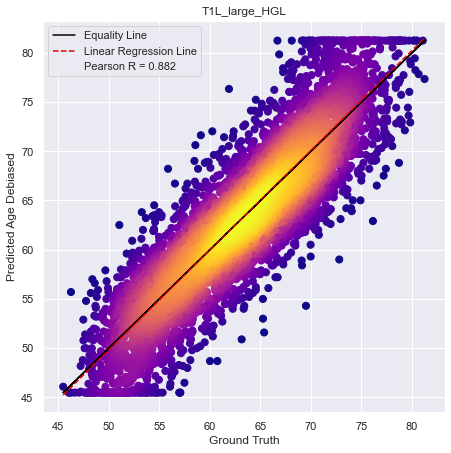

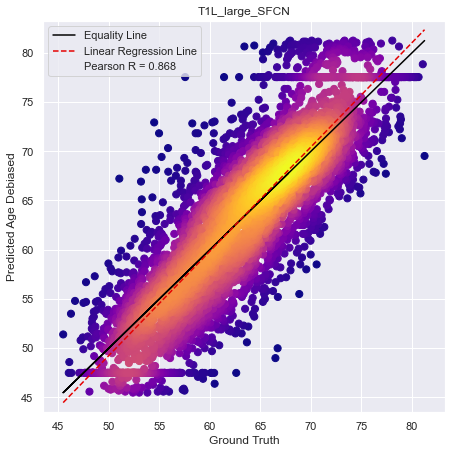

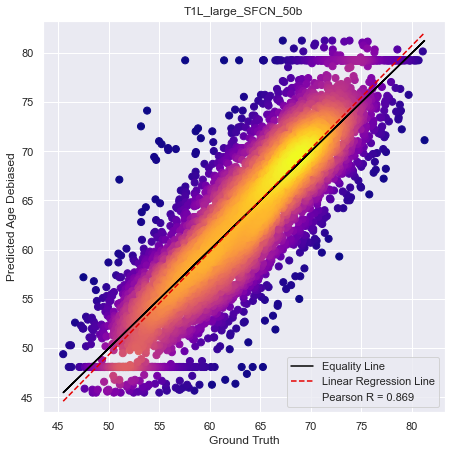

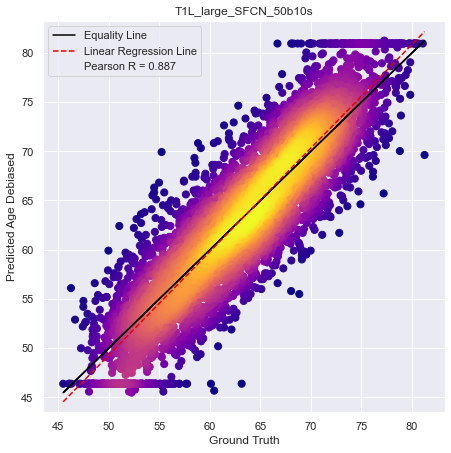

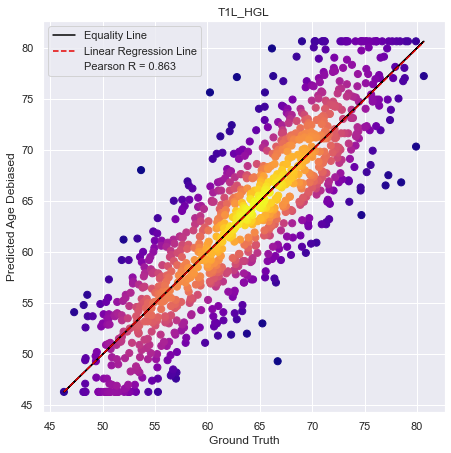

...

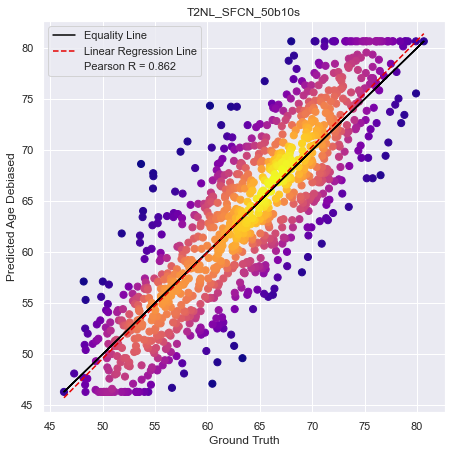

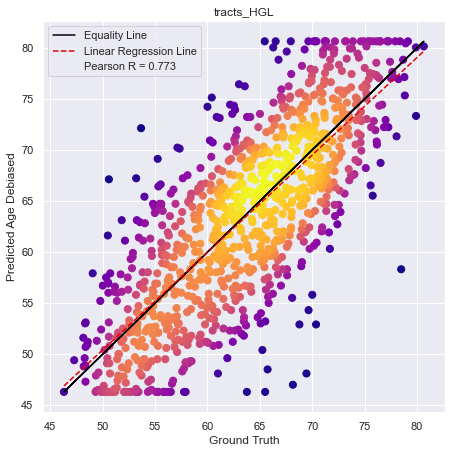

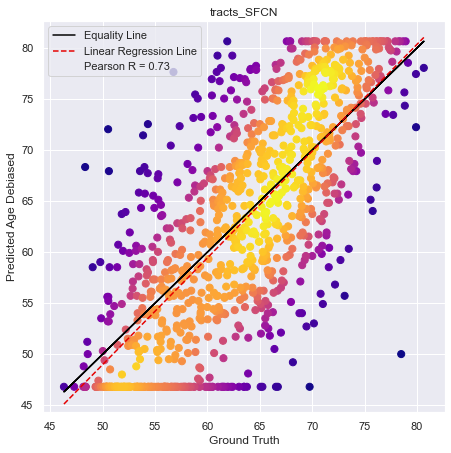

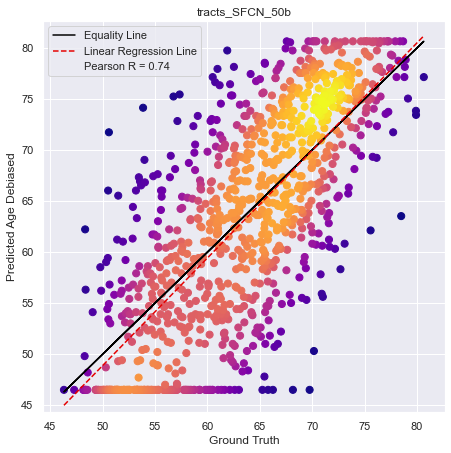

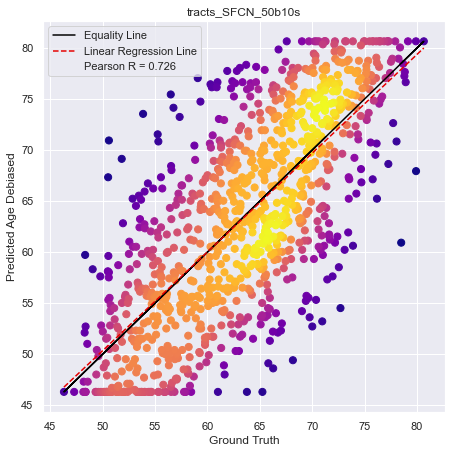

In [10]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.output_age_decon3, xlabel='Ground Truth', 
                               ylabel='Predicted Age Debiased', title=name_mod, set_scale=True)

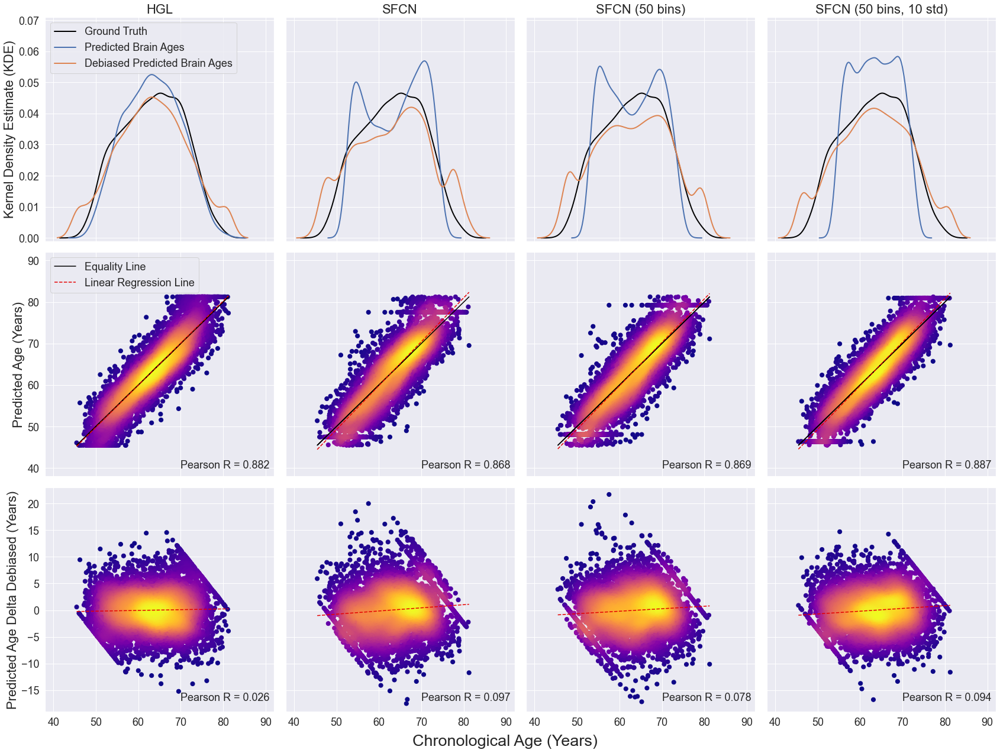

In [71]:
titles = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

legends = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

ncols=4
nrows=3
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

i = 0


for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Kernel Density Estimate (KDE)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon3],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=titles[idx],
                set_hard_scale = [40,90,0,0.07],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break
    

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age (Years)'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.output_age_decon3, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False,
                                        set_hard_scale = [40,90,40,90],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = plot_legend_flag, legend_font = legend_font, 
                                  plot_full_legend=plot_full_legend,
                                  text_x=70, text_y=40,
                                 )
    i+=1
    if idx == 3:
        break
    

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 0:
        ylabel = 'Predicted Age Delta Debiased (Years)'
        x_axis_off_flag=False
        y_axis_off_flag=False
    else:
        ylabel = None
        x_axis_off_flag=False
        y_axis_off_flag=True
    scatter_plot_heatmap_subplots(ax=axes[i], x=df_mod.target_age, y=df_mod.age_delta_decon3, 
                                        xlabel=None, ylabel=ylabel, 
                                        title=None, set_scale=False, equality_line=False, 
#                                   set_y_scale=21,
                                  set_hard_scale = [40,90,-17,21],
                                  title_font_size=title_font_size, 
                                  x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                                  ticks_font_size = ticks_font_size,
                                  plot_legend_flag = False, legend_font = legend_font, 
                                  text_x=70, text_y=-17,
                                 )
    i+=1
    if idx == 3:
        break
    


fig.subplots_adjust(wspace=0.05, hspace=0.05)
fig.supxlabel('Chronological Age (Years)', y=0.10, fontsize=title_font_size+5, verticalalignment='top')
    
# handles, labels = axes.get_legend_handles_labels()
# fig.legend(handles, labels, loc='upper center')
# plt.figlegend( lines, labels, loc = 'lower center', ncol=5, labelspacing=0. )
# lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
# lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
# fig.legend(lines, labels)
    
fig.savefig('Scatter_Plots_DEBIASED_3.png', bbox_inches='tight')
    
    

In [73]:
df

,modality,dataframe
0,T1L_large_HGL,Unnamed: 0 target_age mean_output_age ...
1,T1L_large_SFCN,Unnamed: 0 target_age mean_output_age ...
2,T1L_large_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
3,T1L_large_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
4,T1L_HGL,Unnamed: 0 target_age mean_output_age ...
5,T1L_SFCN,Unnamed: 0 target_age mean_output_age ...
6,T1L_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
7,T1L_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
8,T1NL_HGL,Unnamed: 0 target_age mean_output_age ...
9,T1NL_SFCN,Unnamed: 0 target_age mean_output_age ...


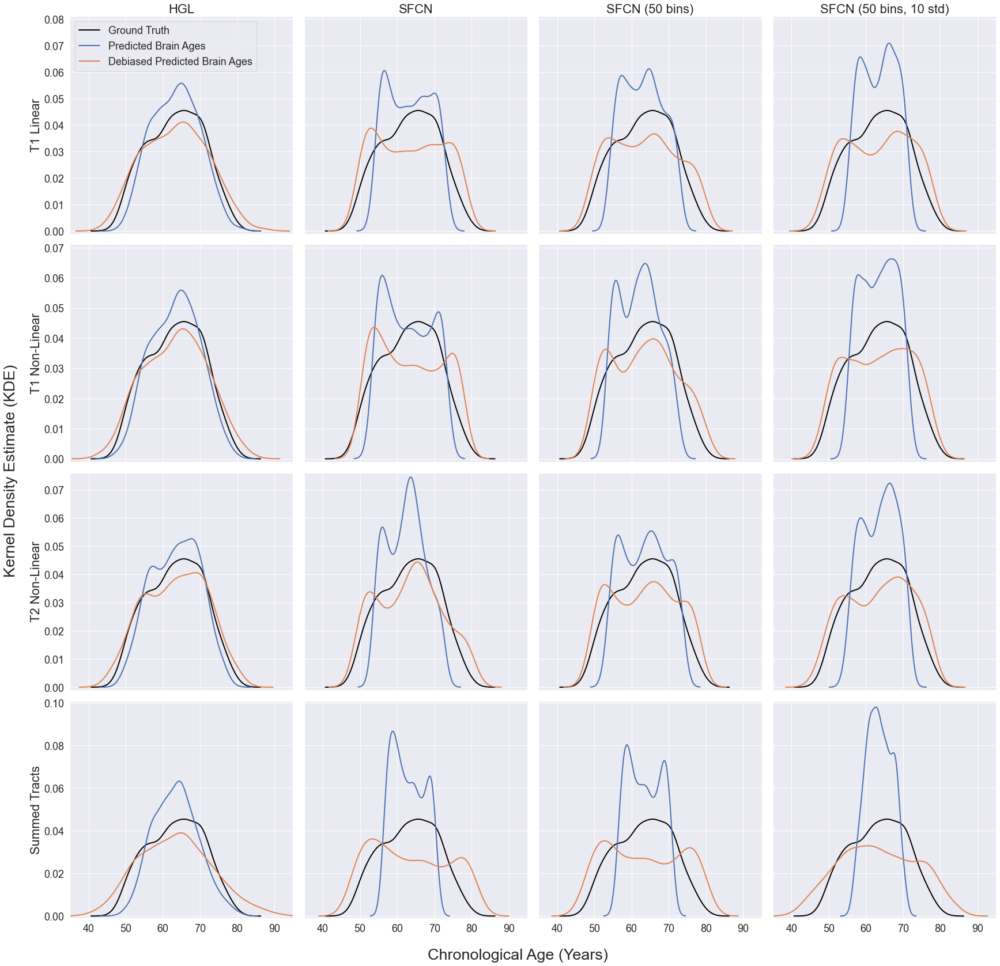

In [96]:
titles = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

legends = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

ncols=4
nrows=4
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

i = 0

for idx in range(4, 8):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 4:
        ylabel = 'T1 Linear'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = True
        plot_full_legend=True
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=titles[idx-4],
                set_hard_scale = [37,93,0,0.08],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break
        
for idx in range(8, 12):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 8:
        ylabel = 'T1 Non-Linear'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = False
        plot_full_legend=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=None,
                set_hard_scale = [37,93,0,0.07],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break
        
for idx in range(12, 16):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 12:
        ylabel = 'T2 Non-Linear'
        x_axis_off_flag=True
        y_axis_off_flag=False
        plot_legend_flag = False
        plot_full_legend=False
    else:
        ylabel = None
        x_axis_off_flag=True
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=None,
                set_hard_scale = [37,93,0,0.075],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break
        

for idx in range(16, 20):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    if idx == 16:
        ylabel = 'Summed Tracts'
        x_axis_off_flag=False
        y_axis_off_flag=False
        plot_legend_flag = False
        plot_full_legend=False
    else:
        ylabel = None
        x_axis_off_flag=False
        y_axis_off_flag=True
        plot_legend_flag = False
        plot_full_legend=False
    
    kde_subplot(ax=axes[i], x=df_mod.target_age, y=[df_mod.mean_output_age, df_mod.output_age_decon],
                xlegend='Ground Truth', 
#                 ylegend=[legends[idx], legends[idx] + ' Debiased'],
                xlabel=None, ylabel=ylabel, title=None,
                set_hard_scale = [37,93,0,0.1],
               title_font_size=title_font_size,
               x_axis_off_flag=x_axis_off_flag, y_axis_off_flag=y_axis_off_flag,
                ticks_font_size = ticks_font_size,
                plot_legend_flag=plot_legend_flag, legend_font=legend_font
               )
    i+=1
    if idx == 3:
        break   

fig.subplots_adjust(wspace=0.05, hspace=0.05)
fig.supxlabel('Chronological Age (Years)', y=0.10, fontsize=title_font_size+5, verticalalignment='top')
fig.supylabel('Kernel Density Estimate (KDE)', x=0.07, fontsize=title_font_size+5, verticalalignment='center')



    
# handles, labels = axes.get_legend_handles_labels()
# fig.legend(handles, labels, loc='upper center')
# plt.figlegend( lines, labels, loc = 'lower center', ncol=5, labelspacing=0. )
# lines_labels = [ax.get_legend_handles_labels() for ax in fig.axes]
# lines, labels = [sum(lol, []) for lol in zip(*lines_labels)]
# fig.legend(lines, labels)
    
fig.savefig('Scatter_Plots_SMALL_DATASETS.png', bbox_inches='tight')
    
    

In [65]:
range(4, len(df))

range(4, 20)

In [66]:
df

,modality,dataframe
0,T1L_large_HGL,Unnamed: 0 target_age mean_output_age ...
1,T1L_large_SFCN,Unnamed: 0 target_age mean_output_age ...
2,T1L_large_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
3,T1L_large_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
4,T1L_HGL,Unnamed: 0 target_age mean_output_age ...
5,T1L_SFCN,Unnamed: 0 target_age mean_output_age ...
6,T1L_SFCN_50b,Unnamed: 0 target_age mean_output_age ...
7,T1L_SFCN_50b10s,Unnamed: 0 target_age mean_output_age ...
8,T1NL_HGL,Unnamed: 0 target_age mean_output_age ...
9,T1NL_SFCN,Unnamed: 0 target_age mean_output_age ...


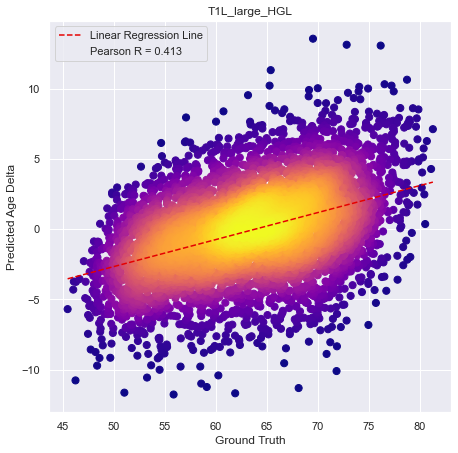

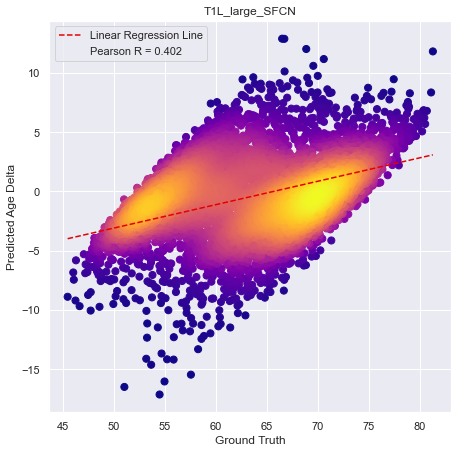

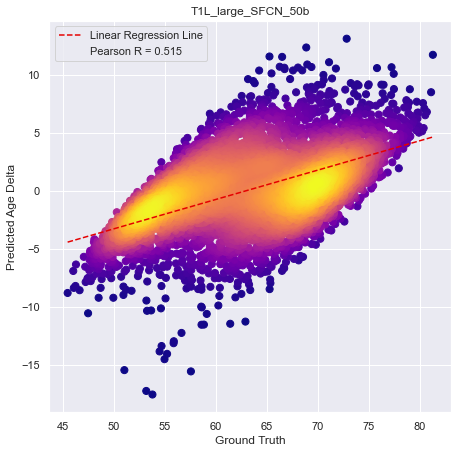

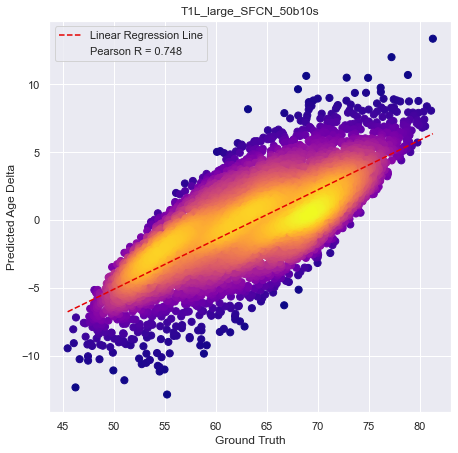

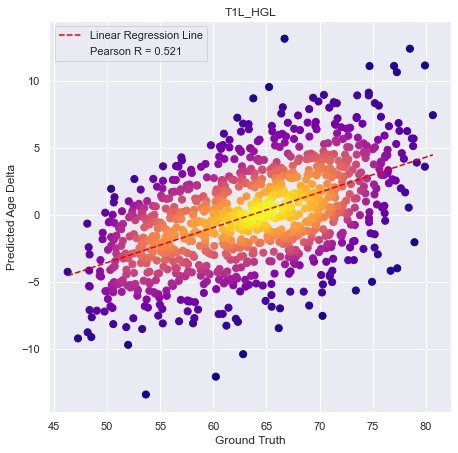

...

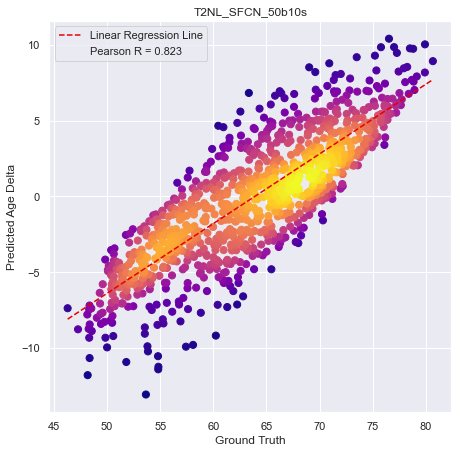

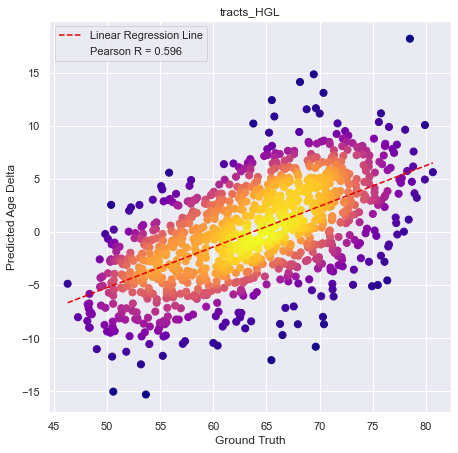

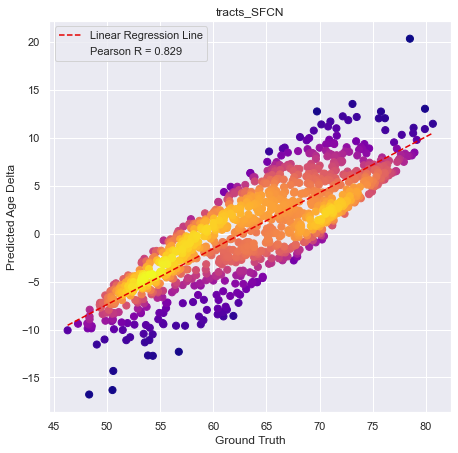

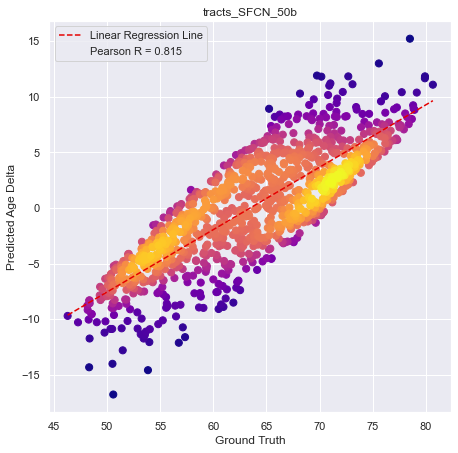

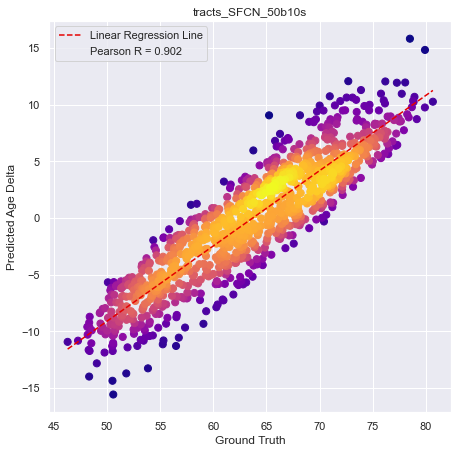

In [11]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.mean_age_delta, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta', title=name_mod, set_scale=False, 
                               equality_line=False)

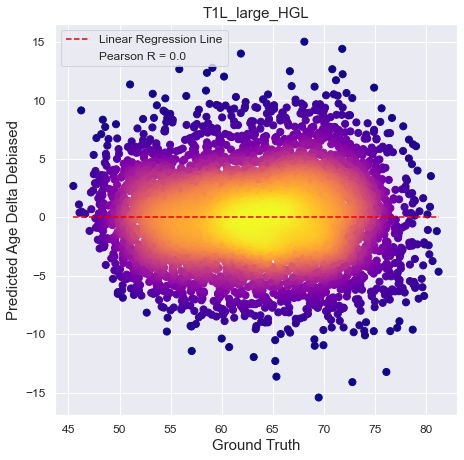

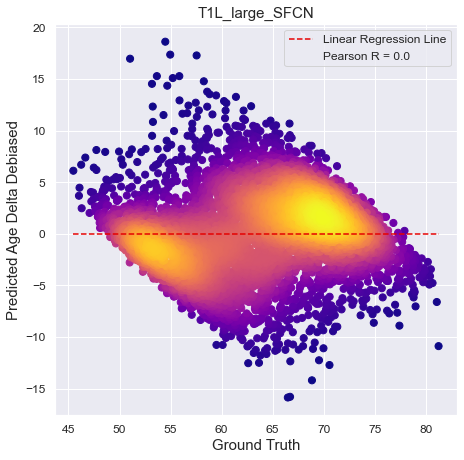

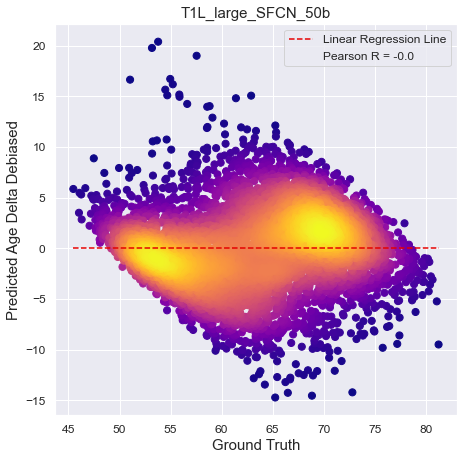

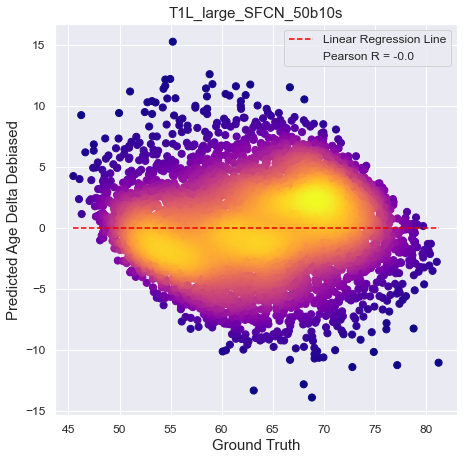

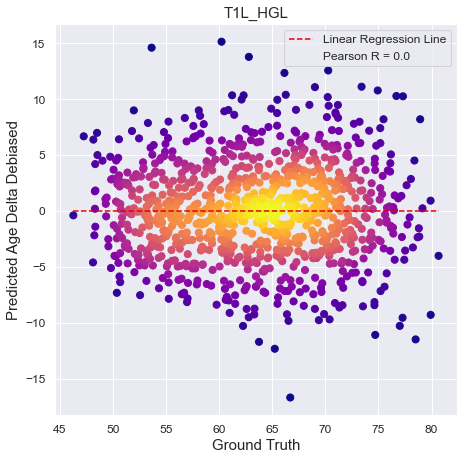

...

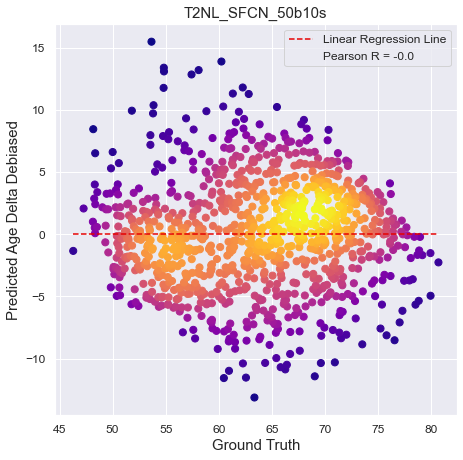

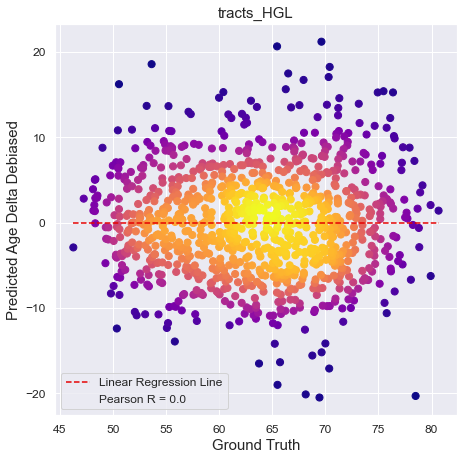

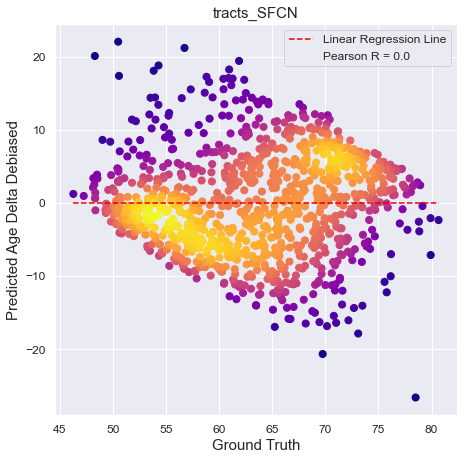

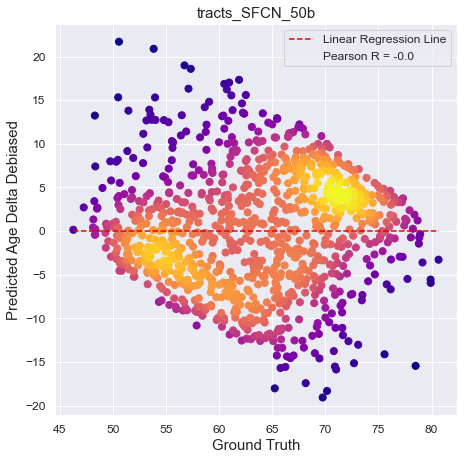

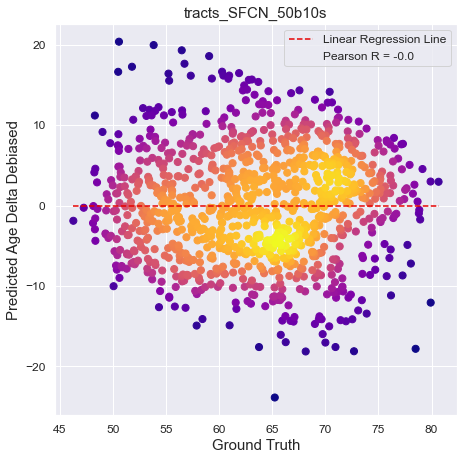

In [99]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.age_delta_decon, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta Debiased', title=name_mod, set_scale=False, 
                               equality_line=False)

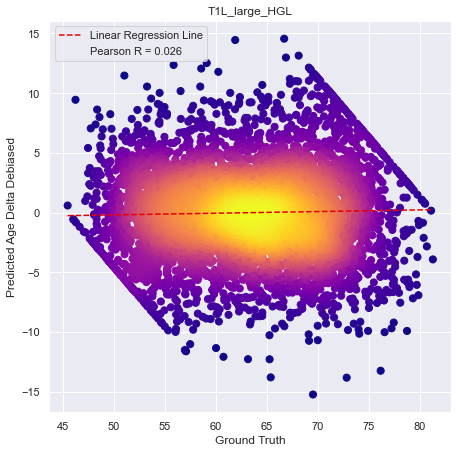

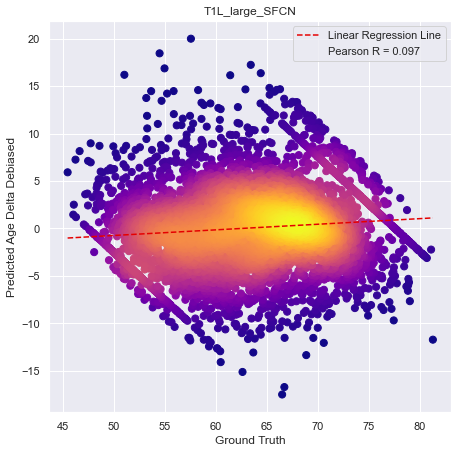

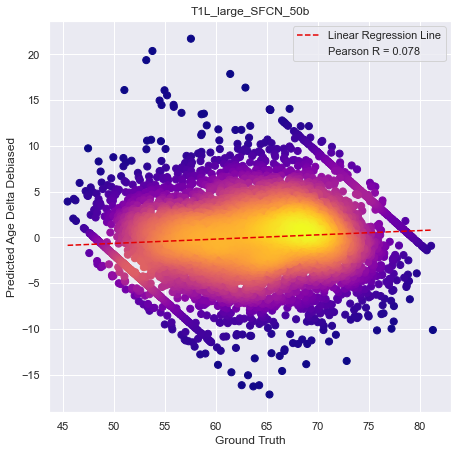

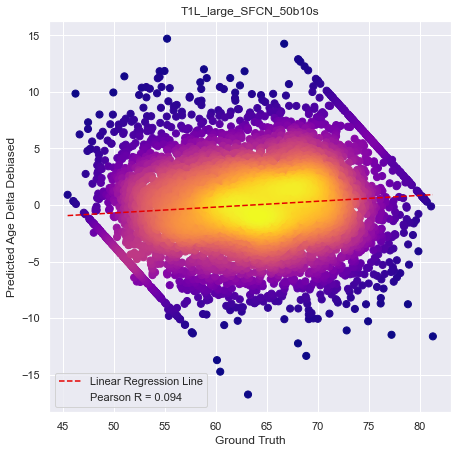

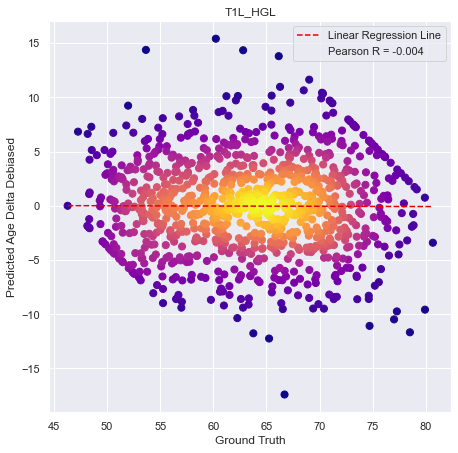

...

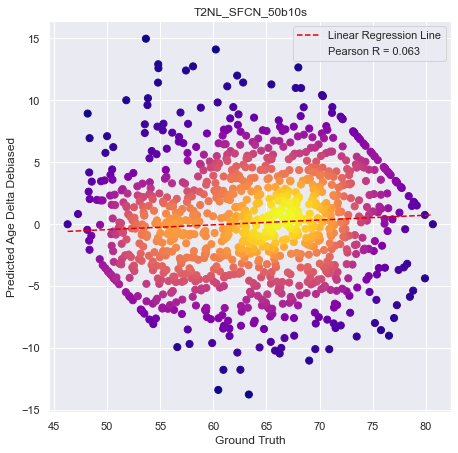

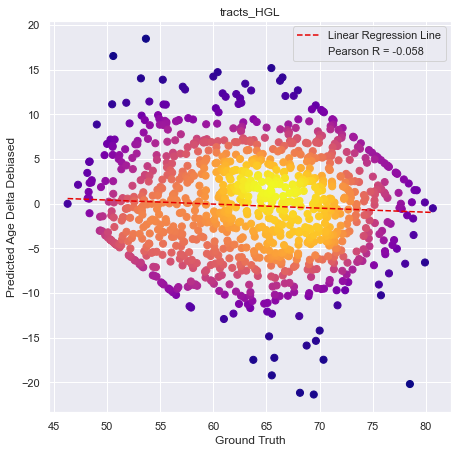

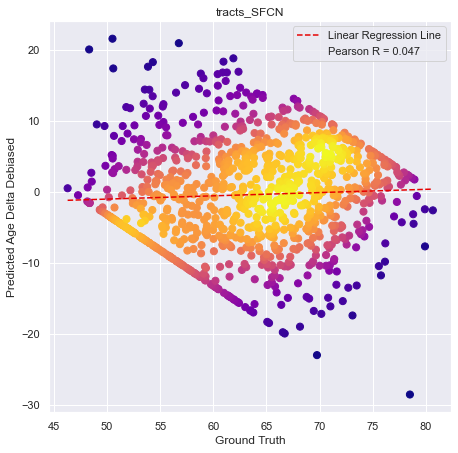

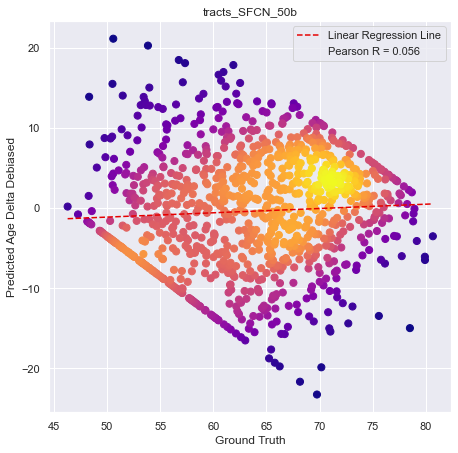

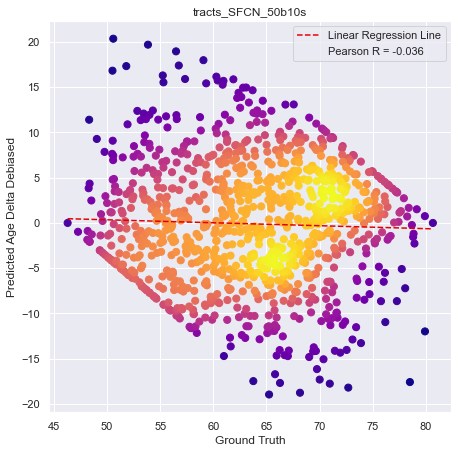

In [13]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = scatter_plot_heatmap(x=df_mod.target_age, y=df_mod.age_delta_decon3, xlabel='Ground Truth', 
                               ylabel='Predicted Age Delta Debiased', title=name_mod, set_scale=False, 
                               equality_line=False)

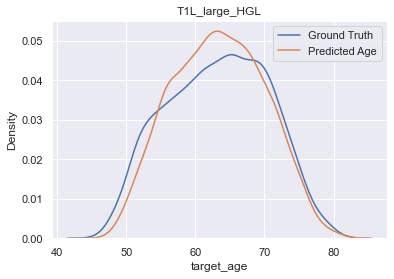

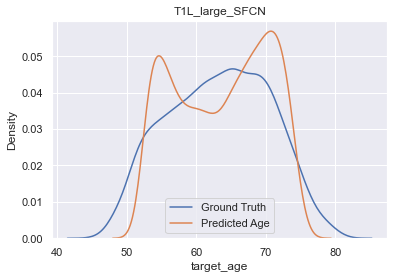

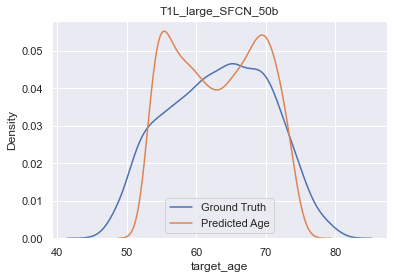

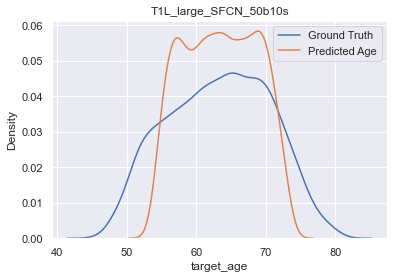

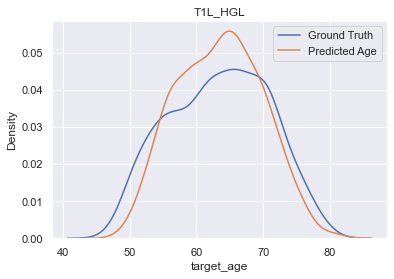

...

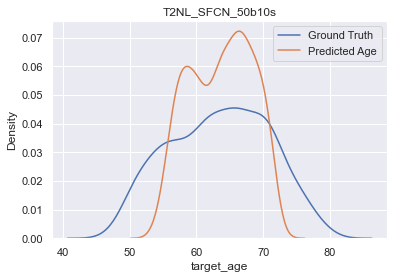

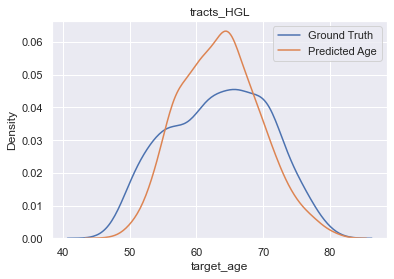

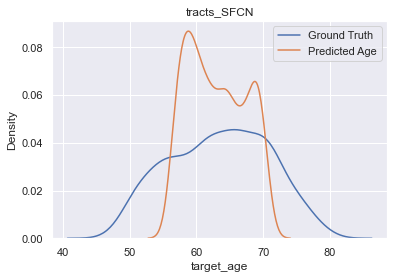

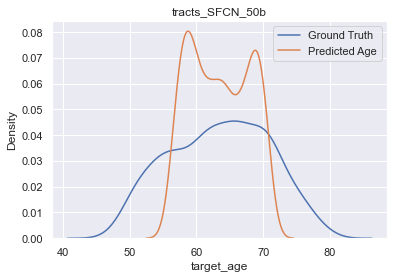

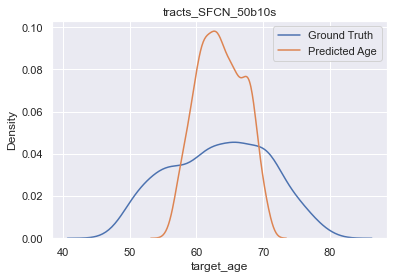

In [14]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = kde_plot(x=df_mod.target_age, y=df_mod.mean_output_age, 
                   xlabel='Ground Truth', ylabel='Predicted Age',
                   title=name_mod)

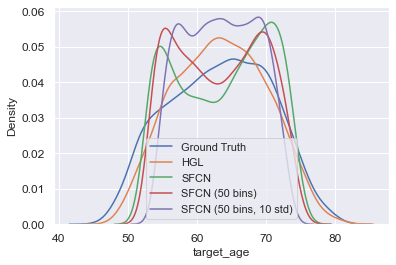

In [46]:
titles = [
    'HGL',
    'SFCN',
    'SFCN (50 bins)',
    'SFCN (50 bins, 10 std)',
]

sns.kdeplot(df.iloc[0].dataframe.target_age, label='Ground Truth')

for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality   
    sns.kdeplot(df_mod.mean_output_age, label= titles[idx])
    
    if idx==3:
        break
    
plt.legend()

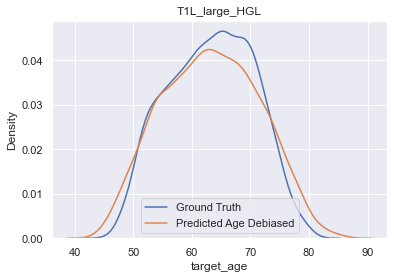

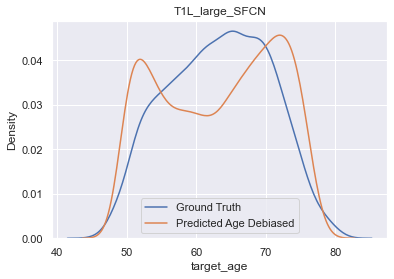

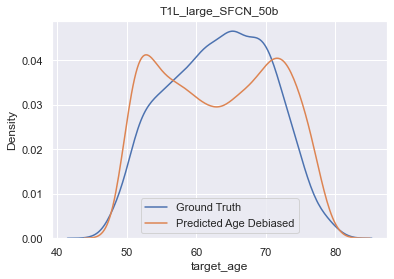

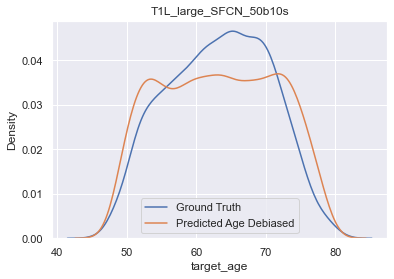

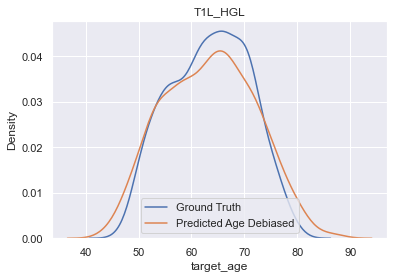

...

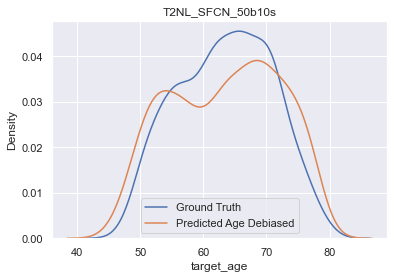

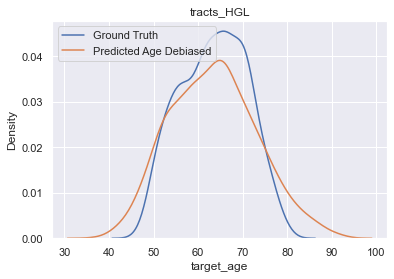

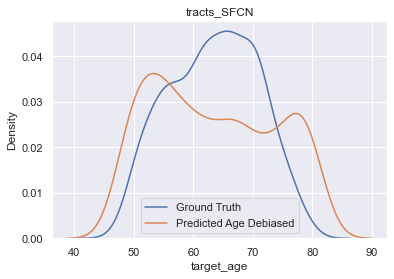

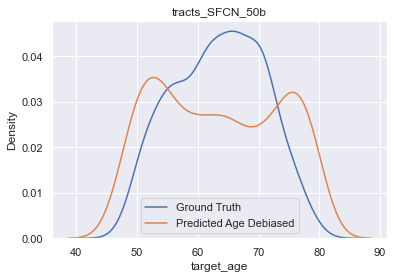

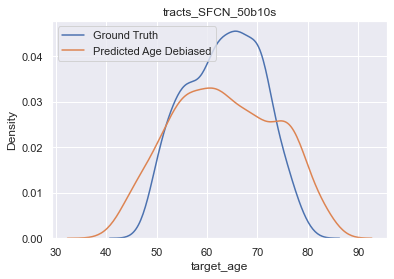

In [15]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = kde_plot(x=df_mod.target_age, y=df_mod.output_age_decon, 
                   xlabel='Ground Truth', ylabel='Predicted Age Debiased',
                   title=name_mod)

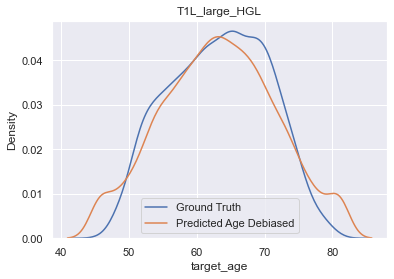

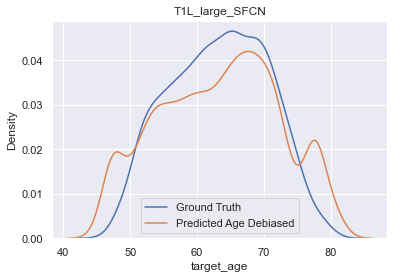

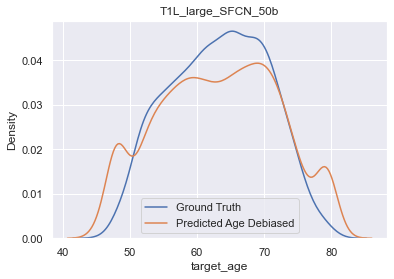

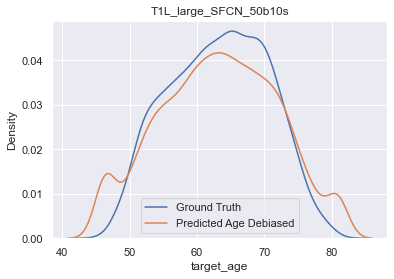

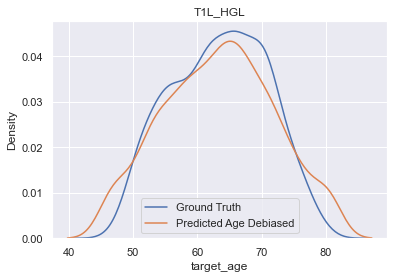

...

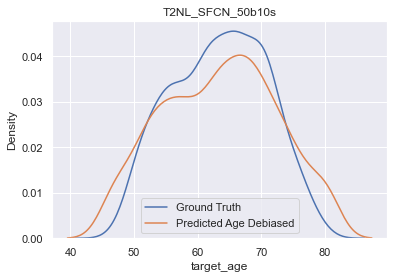

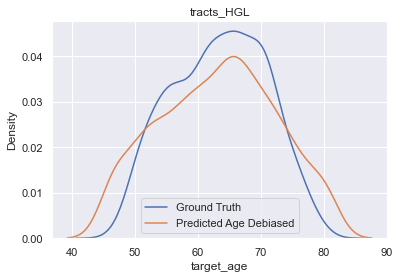

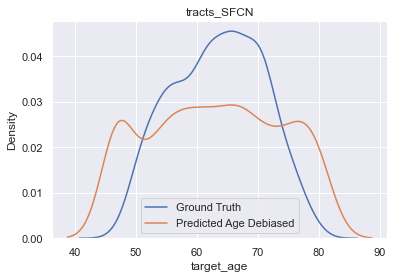

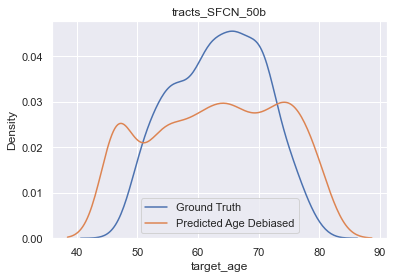

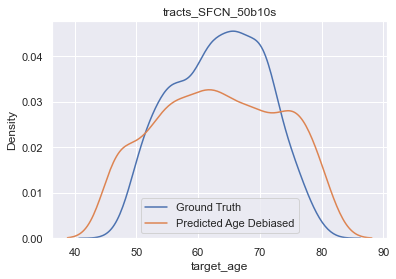

In [16]:
for idx in range(len(df)):
    df_mod = df.iloc[idx].dataframe
    name_mod = df.iloc[idx].modality
    fig = kde_plot(x=df_mod.target_age, y=df_mod.output_age_decon3, 
                   xlabel='Ground Truth', ylabel='Predicted Age Debiased',
                   title=name_mod)

In [107]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import tensorboard as tb
import os
from tensorboard.backend.event_processing import event_accumulator

In [133]:
def tensorboard_reader(directory, tag='AgeDelta/epoch'):
    """
    Sources: 
    https://stackoverflow.com/questions/41074688/how-do-you-read-tensorboard-files-programmatically
    https://stackoverflow.com/questions/37304461/tensorflow-importing-data-from-a-tensorboard-tfevent-file
    """
    
    for dataset in ['train', 'validation']:
    
        dct = {}
        steps = []
        values = []
    
        if dataset == 'train':
            dir_name = directory + '/train/'
        else:
            dir_name = directory + '/validation/'

        list_of_files = os.listdir(dir_name)

        for file in list_of_files:
            file_name=dir_name+file
#             print(file_name)
            ea = event_accumulator.EventAccumulator(file_name,
              size_guidance={
              event_accumulator.COMPRESSED_HISTOGRAMS: 500,
              event_accumulator.IMAGES: 4,
              event_accumulator.AUDIO: 4,
              event_accumulator.SCALARS: 0,
              event_accumulator.HISTOGRAMS: 1,
          })
            ea.Reload()
#             print(ea.Tags())
            if tag in ea.Tags()['scalars']:
                for e in ea.Scalars(tag):
                    step = e.step
                    value = e.value
                    steps.append(step)
                    values.append(value)

        dct['step'] = steps
        
        if dataset == 'train':
            dct['train'] = values
            dfp = pd.DataFrame.from_dict(dct)
        else:
            dct['validation'] = values
            dfv = pd.DataFrame.from_dict(dct)

    df = pd.merge(dfp, dfv, how='left', on='step')
    df = df.sort_values('step')
    
    return df

def linear_plotter(x, y_train, y_validation, xlabel, ylabel, title, ylim_flag=False):
    
    plt.figure(figsize=[7,5])
    plt.plot(x, y_train, label='Train')
    plt.plot(x, y_validation, label='Validation')
    plt.xlabel(xlabel)
    if ylim_flag == True:
        ylim_min = -0.25
        ylim_max = np.max(y_train) + 5
        plt.ylim((ylim_min, ylim_max))
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.show()
    
def linear_plotter_comparison(x1, y1, x2, y2,
                              y1label, y2label,
                              xlabel, ylabel, title, ylim_flag=False):
    
    plt.figure(figsize=[7,5])
    plt.plot(x1, y1, label=y1label)
    plt.plot(x2, y2, label=y2label)
    plt.xlabel(xlabel)
    if ylim_flag == True:
        ylim_min = -0.25
        ylim_max = min(np.max(y1), np.max(y2))
        plt.ylim((ylim_min, ylim_max))
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend()
    plt.show()

In [134]:
experiment_id = '../logs/AM0-81'

In [135]:
end_point = 80
start_point = 81
steps = start_point - end_point + 1
range_points = np.linspace(end_point,start_point,steps)

# range_points = [227, 254, 255]

dfs = []
names = []

tag = 'AgeDelta/epoch'
for i in range_points:
    name = 'AM0-' + str(int(i))
    directory = '../logs/' + name
#     if os.path.isdir(directory):
    df = tensorboard_reader(directory=directory, tag=tag)
    dfs.append(df)
    names.append(name)

dfs2 = []
names2 = []
    
tag2 = 'LearningRate/iteration'
for i in range_points:
    name2 = 'AM0-' + str(int(i))
    directory2 = '../logs/' + name
#     if os.path.isdir(directory):
    df2 = tensorboard_reader(directory=directory2, tag=tag2)
    dfs2.append(df2)
    names2.append(name2)

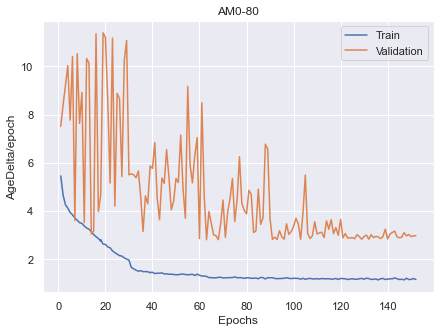

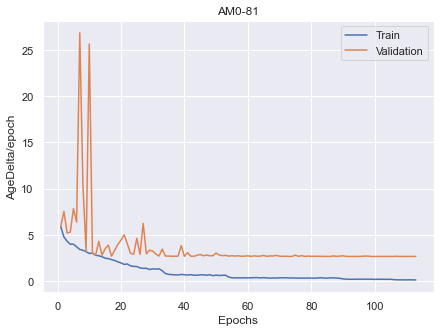

In [110]:
for i, df in enumerate(dfs):
    name = names[i]
    linear_plotter(x=df.step, y_train=df.train, y_validation=df.validation, 
                   xlabel='Epochs', ylabel=tag, title=name)

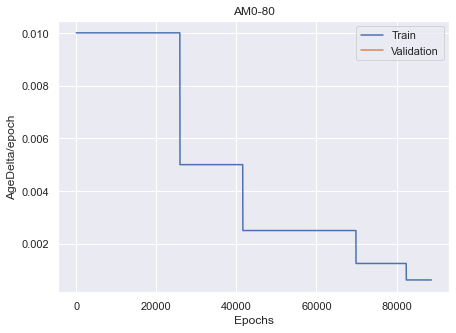

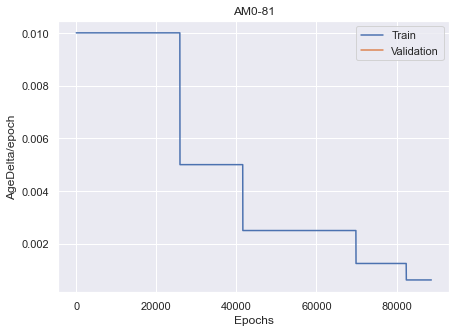

In [136]:
for i, df in enumerate(dfs2):
    name = names[i]
    linear_plotter(x=df.step, y_train=df.train, y_validation=df.validation, 
                   xlabel='Epochs', ylabel=tag, title=name)

In [140]:
dfs[0].step.max()

152

In [141]:
dfs2[0].step.max()

88685

In [143]:
ratio = dfs2[0].step.max() / dfs[0].step.max()
dfs2[0].step = dfs2[0].step / ratio

In [144]:
dfs2[0].step.max()

152.0

In [148]:
dfs2[1].step = dfs2[1].step / (dfs2[1].step.max() / dfs[1].step.max())

In [149]:
dfs2[1].step.max()

113.0

In [152]:
dfs[0].head()

,step,train,validation
25,1,5.447914,7.509033
26,2,4.651337,8.403857
27,3,4.248135,9.209538
28,4,4.108453,10.027864
29,5,3.929838,7.768479


In [153]:
dfs2[0].head()

,step,train,validation
1168,0.001714,0.01,NaN
1169,0.087410,0.01,NaN
1170,0.173107,0.01,NaN
1171,0.258804,0.01,NaN
1172,0.344500,0.01,NaN


Text(0.5, 0, 'Training Epochs')

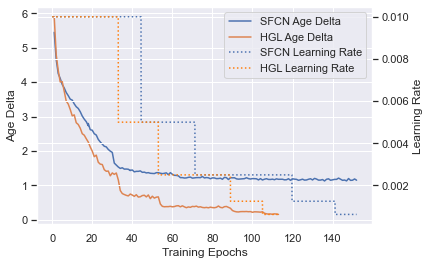

In [183]:
# plt.figure()
# plt.plot(dfs[0].step, dfs[0].train, label='SFCN Train')
# plt.plot(dfs2[0].step, dfs2[0].train, label='SFCN Learning Rate', linestyle='--')

ax1 = plt.subplot()
ax2 = ax1.twinx()
l1, = ax1.plot(dfs[0].step, dfs[0].train,)
l11, = ax1.plot(dfs[1].step, dfs[1].train)
l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')

Text(0.5, 0, 'Training Epochs')

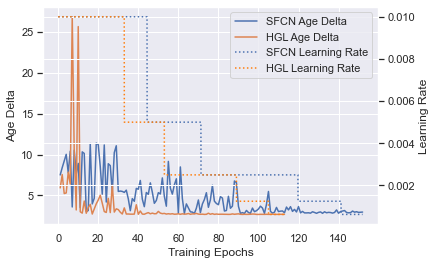

In [191]:
ax1 = plt.subplot()
ax2 = ax1.twinx()
l1, = ax1.plot(dfs[0].step, dfs[0].validation)
l11, = ax1.plot(dfs[1].step, dfs[1].validation)

# ylim_min = -0.25
# ylim_max = np.max(dfs[0].validation) + 5
# ax1.set_ylim((ylim_min, ylim_max))

ax1.grid('off')

l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')



Text(0.5, 17.200000000000003, 'Training Epochs')

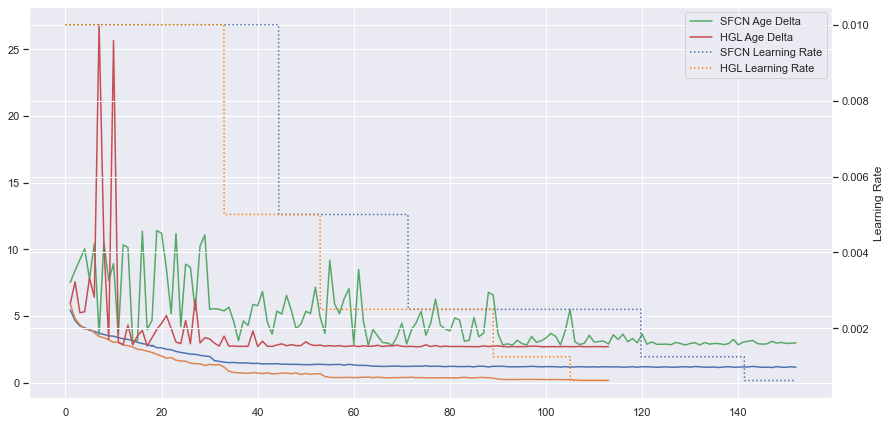

In [195]:
ncols=2
nrows=1
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

axes[0] = plt.subplot()
ax2 = axes[0].twinx()
l1, = axes[0].plot(dfs[0].step, dfs[0].train,)
l11, = axes[0].plot(dfs[1].step, dfs[1].train)
l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')



axes[1] = plt.subplot()
ax2 = axes[1].twinx()
l1, = axes[1].plot(dfs[0].step, dfs[0].validation)
l11, = axes[1].plot(dfs[1].step, dfs[1].validation)

# ylim_min = -0.25
# ylim_max = np.max(dfs[0].validation) + 5
# ax1.set_ylim((ylim_min, ylim_max))

# ax1.grid('off')

l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')



In [ ]:
ncols=2
nrows=1
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

axes[0] = plt.subplot()
ax2 = axes[0].twinx()
l1, = axes[0].plot(dfs[0].step, dfs[0].train,)
l11, = axes[0].plot(dfs[1].step, dfs[1].train)
l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')



axes[1] = plt.subplot()
ax2 = axes[1].twinx()
l1, = axes[1].plot(dfs[0].step, dfs[0].validation)
l11, = axes[1].plot(dfs[1].step, dfs[1].validation)

# ylim_min = -0.25
# ylim_max = np.max(dfs[0].validation) + 5
# ax1.set_ylim((ylim_min, ylim_max))

# ax1.grid('off')

l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

ax1.set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
ax1.set_xlabel('Training Epochs')

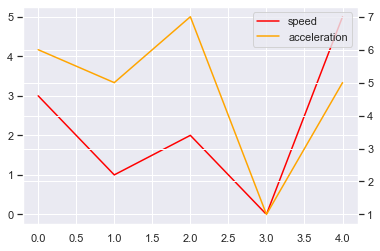

In [167]:
speed = np.array([3, 1, 2, 0, 5])
acceleration = np.array([6, 5, 7, 1, 5])

ax1 = plt.subplot()
l1, = ax1.plot(speed, color='red')
ax2 = ax1.twinx()
l2, = ax2.plot(acceleration, color='orange')

plt.legend([l1, l2], ["speed", "acceleration"])

plt.show()

Text(0.5, 0, 'Training Epochs')

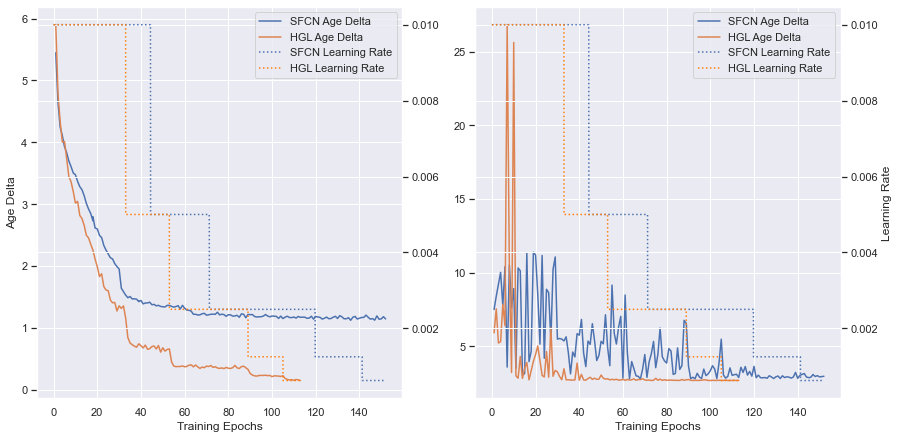

In [198]:
ncols=2
nrows=1
sz=7.2
title_font_size=22
ticks_font_size=18
legend_font = 18

fig, axes = plt.subplots(ncols=ncols,nrows=nrows,figsize=(ncols*sz,nrows*sz))

# axes.set_xlabel('Chronological Age (Years)')

axes = axes.ravel()

axes[0] = plt.subplot(1,2,1)
ax2 = axes[0].twinx()
l1, = axes[0].plot(dfs[0].step, dfs[0].train,)
l11, = axes[0].plot(dfs[1].step, dfs[1].train)
l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

axes[0].set_ylabel('Age Delta')
# ax2.set_ylabel('Learning Rate')
axes[0].set_xlabel('Training Epochs')



axes[1] = plt.subplot(1,2,2)
ax2 = axes[1].twinx()
l1, = axes[1].plot(dfs[0].step, dfs[0].validation)
l11, = axes[1].plot(dfs[1].step, dfs[1].validation)

# ylim_min = -0.25
# ylim_max = np.max(dfs[0].validation) + 5
# ax1.set_ylim((ylim_min, ylim_max))

# ax1.grid('off')

l2, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['SFCN Age Delta', 'HGL Age Delta', 'SFCN Learning Rate', 'HGL Learning Rate'])

# axes[1].set_ylabel('Age Delta')
ax2.set_ylabel('Learning Rate')
axes[1].set_xlabel('Training Epochs')

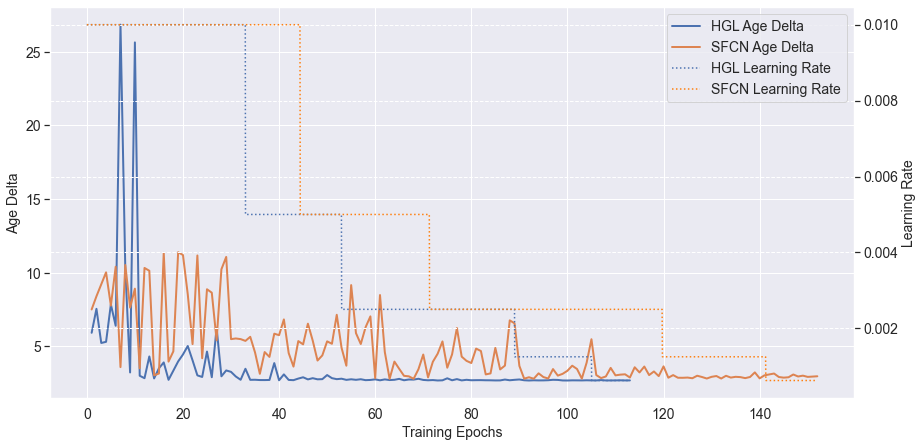

In [236]:
ncols=1
nrows=1
sz=7.2
title_font_size=14
ticks_font_size=14
legend_font = 14

fig = plt.figure(figsize=(ncols*sz*2,nrows*sz))
ax1 = plt.subplot()
ax2 = ax1.twinx()
# ylim_min = 2
# ylim_max = np.max(dfs[0].validation) + 4
# ax1.set_ylim((ylim_min, ylim_max))
# ax2.set_ylim((0.0001, 0.011))

l1, = ax1.plot(dfs[1].step, dfs[1].validation, linewidth = 2)
l11, = ax1.plot(dfs[0].step, dfs[0].validation, linewidth = 2)

l2, = ax2.plot(dfs2[1].step, dfs2[1].train, linestyle='dotted', color='b')
l22, = ax2.plot(dfs2[0].step, dfs2[0].train, linestyle='dotted', color='tab:orange')
plt.legend([l1, l11, l2, l22], ['HGL Age Delta', 'SFCN Age Delta', 'HGL Learning Rate', 'SFCN Learning Rate'],
          fontsize=legend_font)

ax1.set_ylabel('Age Delta', fontsize=title_font_size)
ax2.set_ylabel('Learning Rate', fontsize=title_font_size)
ax1.set_xlabel('Training Epochs', fontsize=title_font_size)

ax1.tick_params(axis='x', labelsize= ticks_font_size)
ax1.tick_params(axis='y', labelsize= ticks_font_size)
ax2.tick_params(axis='y', labelsize= ticks_font_size)

ax2.grid(linestyle='--')

fig.savefig('HGLvsSFCN Val Curves.png', bbox_inches='tight')

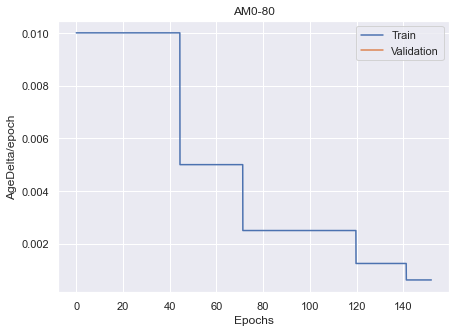

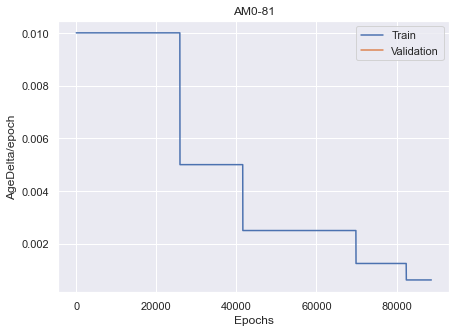

In [145]:
for i, df in enumerate(dfs2):
    name = names[i]
    linear_plotter(x=df.step, y_train=df.train, y_validation=df.validation, 
                   xlabel='Epochs', ylabel=tag, title=name)

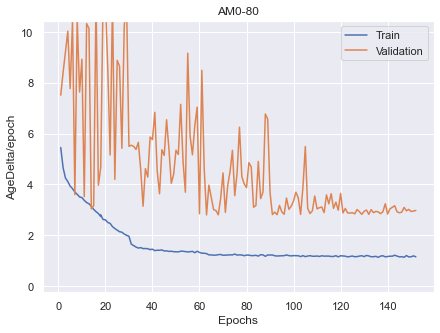

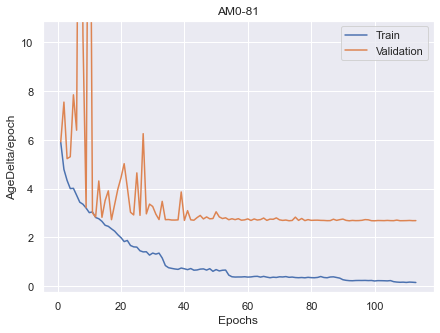

In [111]:
for i, df in enumerate(dfs):
    name = names[i]
    linear_plotter(x=df.step, y_train=df.train, y_validation=df.validation, 
                   xlabel='Epochs', ylabel=tag, title=name, ylim_flag=True)

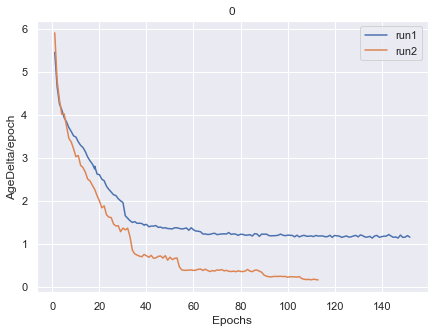

In [119]:
for i in [0]:
    linear_plotter_comparison(x1=dfs[i].step, y1=dfs[i].train, 
                              x2=dfs[i+1].step, y2=dfs[i+1].train, 
                              y1label='run1', y2label='run2',
                              xlabel='Epochs', ylabel='AgeDelta/epoch', title=str(i), ylim_flag=False)

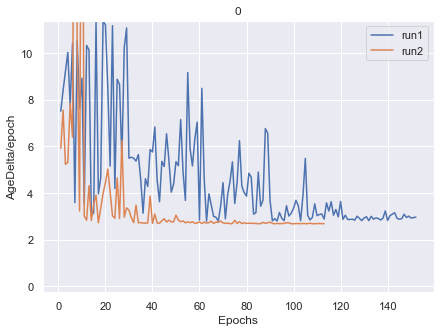

In [123]:
for i in [0]:
    linear_plotter_comparison(x1=dfs[i].step, y1=dfs[i].validation, 
                              x2=dfs[i+1].step, y2=dfs[i+1].validation, 
                              y1label='run1', y2label='run2',
                              xlabel='Epochs', ylabel='AgeDelta/epoch', title=str(i), ylim_flag=True)

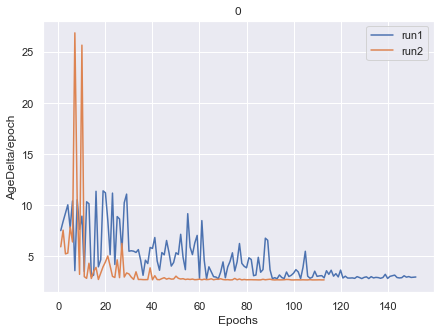

In [125]:
for i in [0]:
    linear_plotter_comparison(x1=dfs[i].step, y1=dfs[i].validation, 
                              x2=dfs[i+1].step, y2=dfs[i+1].validation, 
                              y1label='run1', y2label='run2',
                              xlabel='Epochs', ylabel='AgeDelta/epoch', title=str(i))

In [126]:
dfs

[    step     train  validation
 25     1  5.447914    7.509033
 26     2  4.651337    8.403857
 27     3  4.248135    9.209538
 28     4  4.108453   10.027864
 29     5  3.929838    7.768479
 ..   ...       ...         ...
 80   148  1.196174    2.956605
 81   149  1.142553    3.013747
 82   150  1.148328    2.930082
 83   151  1.183866    2.948227
 84   152  1.147547    2.971797
 
 [154 rows x 3 columns],
     step     train  validation
 73     1  5.901009    5.923512
 74     2  4.792239    7.553043
 75     3  4.339923    5.232425
 76     4  4.004911    5.311746
 77     5  4.015066    7.852307
 ..   ...       ...         ...
 60   109  0.166180    2.688303
 61   110  0.155462    2.691128
 62   111  0.169120    2.697158
 63   112  0.162321    2.688982
 64   113  0.152673    2.691020
 
 [113 rows x 3 columns]]